<h1 style='text-align: center; font-family: "Times New Roman"; max-width: 1024px;'>
Prediction of Mesh-wise Demographic Composition in Japan from Satellite Images Using Convolutional Neural Network with Transfer Learning
</h1>

<div style='text-align: center; font-family: "Times New Roman"; font-size: 100%; line-height: 120%; max-width: 1024px;'>
Candidate number: 42269<br>Word count: 8,057 words 
</div>

<div style='text-align: justify; font-family: "Times New Roman"; font-size: 100%; line-height: 120%; max-width: 1024px;'>
<i>Abstract: Population aging is one of the most serious problems in certain countries. In order to implement its countermeasures, understanding its rapid progress is of urgency with a granular resolution. However, a detailed and rigorous survey with high frequency is not feasible due to the constraints of financial and human resources. Nowadays, Deep Learning is prevalent for pattern recognition with significant accuracy, with its application to remote sensing. This paper proposes a multi-head Convolutional Neural Network model with transfer learning from ResNet50 for estimating mesh-wise demographics of Japan as one of the most aged countries in the world, with satellite images from Landsat-8/OLI and Suomi NPP/VIIRS-DNS as inputs and census demographics as labels. The trained model was performed on a testing dataset with a test score of at least 0.8914 in $R^2$ for all the demographic composition groups, and the estimated demographic composition was generated and visualised for 2022 as a non-census year.</i></div>

<div style='text-align: justify; font-family: "Times New Roman"; font-size: 100%; line-height: 120%; max-width: 1024px;'>
<i><b>Key words:</b> Demographic Composition Estimation, Population Aging, Japan, Remote Sensing, Convolutional Neural Network, Transfer Learning</i></div>

<h2 style='text-align: justify; font-family: "Times New Roman"; max-width: 1024px;'>
1. Introduction
</h2>

<div style='text-align: justify; font-family: "Times New Roman"; font-size: 100%; line-height: 120%; max-width: 1024px;'>
While the total population of human beings has increased radically, some countries and regions are being faced with unprecedented aging of society. According to the World Health Organization (2022), 1 in 6 people in the world will be more than 60 years old, and its number will be doubled from 1 billion in 2020 to 2.1 billion in 2050. The radical change of demographic composition in countries and regions would affect the feasibility of social welfare and urban planning policies of governments such as pensions, medical care, transportation, and the other physical and social infrastructure (Bongaarts, 2004; Alley et al., 2007). In order to adjust to the transition of societies, obtaining up-to-date demographic composition is of urgent importance. As seen in the case of Italy (Kertzer et al., 2009), a low fertility rate stems from multiple factors including identity towards family, employability, and composition of family, but the importance of each factor highly varies depending on sub-regions. In terms of making data-driven decisions on the population aging with high geographic heterogeneity, it is not sufficient to only obtain the total population, but instead crucial to gain metrics of the demographic composition. One of the most accurate and detailed data sources for demographic composition is a census of each country. Although the granularity varies depending on countries and regions, a census provides precise attributes of residents in each tract or mesh at some timing of “census year”, such as population by age, number of households, and average income in the area. However, due to its thorough methodology and financial or administrative constraints, a census is usually conducted every several years, such as ten years in the U.S. and the U.K. (U.S. Census Bureau, 2022; Office for National Statistics 2023). Thus, it is not feasible to take place similar national surveys more frequently, such as on an annual basis, and approximation is required by estimation from other data sources.</div>

<div style='text-align: justify; font-family: "Times New Roman"; font-size: 100%; line-height: 120%; max-width: 1024px;'>
Among others, Japan is now being suffered from the unprecedented population aging in the history of human beings. According to the World Bank (2023), the ratio of people with ages over 65 years old occupied 30.0 percent of the whole population in Japan, which is the second highest among all the other countries next to Monaco. In parallel, the polarisation of the population is gaining momentum with Tokyo Metropolitan Area enjoying the population influx from the other regions since the 1970s (Ministry of Land, Infrastructure, Transport and Tourism, 2020). Under the circumstances, there are an increasing number of “marginal settlements” (Genkai shūraku) in the rural area, where lives became infeasible due to the lack of young labours and/or infrastructure and the residents would have to abandon their housings to migrate to the urban area (Feldhoff, 2013). Considering the fast pace of population aging with an estimation of the population ratio over 65 years old as 38.8% by 2050 (Nakatani, 2019), it is crucial to understand the up-to-date demographic composition in a granular manner, from the perspective of urban and regional planning. Although the Statistics Bureau of Japan is providing the mesh-wise demographic composition as the result of the census, the interval of its provision is every five years (Statistics Bureau of Japan, 2023b). To fulfill the gap between the census years, precise estimation is of importance.</div>

<div style='text-align: justify; font-family: "Times New Roman"; font-size: 100%; line-height: 120%; max-width: 1024px;'>
Nowadays, pattern recognition of non-linear relationships between different types of datasets is prevalent with potential application to problems in geography, due to the increase of data volume and new machine learning algorithms proposed (Singleton and Arribas-bel, 2021). In particular, Deep Learning models as extensions of Artificial Neural Network (ANN) have shown remarkable performances in the area of remote sensing, utilising satellite images (i.e. land-use classification by Campos-Taberner et al., 2020). Since some well-known satellites such as Landsat-8 (USGS, 2023), Sentinel-2 (ESA, 2023), and Suomi NPP (NOAA, 2023) periodically observe the surface of the Earth globally, they constantly provide a rich amount of data source possibly enough to approximate the other socio-economic variables. When it comes to the estimation of population, previous studies have already tried to estimate the population density from satellite images using Convolutional Neural Network (CNN) such as in India (Hu et al., 2019) and China (Cheng et al., 2021; Huang et al., 2021). However, the estimation of demographic composition rather than the total population is understudied in the context of population aging. This is mainly because the estimation of the population tended to focus on capturing the fast pace of urbanisation around cities in ‘developing’ countries, where rigid data source like census is radically not available. Moreover, some models from the previous studies relied on a complex mixture of multiple data sources, including Point-of-Interest (POI) data (i.e. Cheng et al., 2021). Although better prediction scores could be expected as the variety and amount of input data are increased, this approach implicitly lowers the generalisability of models because of data availability depending on the area of interest. Thus, it is important to develop prediction models by intentionally limiting the input data source only to those available commonly among countries and regions which are (and will be) suffering from population aging.
</div>

<div style='text-align: justify; font-family: "Times New Roman"; font-size: 100%; line-height: 120%; max-width: 1024px;'>
Being aware of the issues mentioned above, this paper proposes a CNN model of predicting the demographic composition of Japan on an annual basis, from the satellite images of Landsat-8 and Suomi NPP, which are publicly available at any location on the Earth. Since the mesh-wise census demographic composition is available in Japan every five years, this paper employs demographic composition from the census conducted in 2015 and 2020 as labels for training, validation, and testing. At the end of the paper, a new dataset is synthesised from the satellite images in 2022, which is not a census year. Due to the public data availability in any country and region, this paper shall be significant in the sense that it has generalisability of granular estimation of demographic composition not only in Japan but also the other countries and regions.
</div>

<h2 style='text-align: justify; font-family: "Times New Roman"; max-width: 1024px;'>
2. Literature Review
</h2>

<h3 style='text-align: justify; font-family: "Times New Roman"; max-width: 1024px;'>
<i>Remote sensing for demographics estimation before Deep Learning</i>
</h3>

<div style='text-align: justify; font-family: "Times New Roman"; font-size: 100%; line-height: 120%; max-width: 1024px;'>
In the field of remote sensing, satellite images have been utilised for a variety of purposes such as tracking desertification, aerosol pollution, and urbanisation (Jenice and Raimond, 2016). Since its first launch in 1972, Landsat Missions operated by the U.S. Geological Survey (USGS) and National Aeronautics and Space Administration (NASA) have been employed as a major source of surface reflectance of the whole globe (USGS, 2023). Although the history is relatively shallower, Sentinel Mission from European Space Agency (ESA) followed Landsat as another source of satellite images since the first launch in 2014 with several applications including cropland monitoring, forest ecology, and urbanisation (ESA, 2023; Phiri et al. 2020). When it comes to demographics estimation, Wu and Murray (2007) estimated the urban population of Ohio in the U.S. from the impervious surface pixel value of Landsat-7 Enhanced Thematic Mapper (ETM+) images, by Ordinary Least Square (OLS) regression on a pixel basis and Spatial Autoregressive model (SAR) on a zonal basis. However, as the authors stated, the accuracy of the zonal estimation was “unacceptable” due to the lack of capturing non-linearity in the pattern of pixels with a linear regression model.
</div>

<div style='text-align: justify; font-family: "Times New Roman"; font-size: 100%; line-height: 120%; max-width: 1024px;'>
While Landsat and Sentinel are observing the earth's surface reflectance in the daytime, other satellites focus on night-time light (NTL). With the global coverage, Defence Meteorological Satellite Program’s Operational Linescan System (DMSP-OLS) by the U.S. Department of Defence and Suomi National Polar-Orbiting Partnership’s Visible Infrared Imaging Radiometer Suite Day-Night Band (Suomi-NPP/VIIRS-DNB) are ones of the major sources for NTL (Barentine et al. 2021). Previous studies pointed out that NTL could approximate socio-economic indicators such as land-use boundary (Henderson et al., 2003) and GDP (Henderson et al., 2012; Mellander et al., 2015). For the estimation of population, Bagan and Yamagata (2015) clarified the correlations between NTL from DMSP-OLS and 1km mesh-wise population density in Hokkaido Prefecture, Japan by geographically weighted regression (GWR), with a prediction score of 0.8833 in $R^2$. Wang et al. (2020) estimated 100m grid-wise population density in China using multiple sources including NTL from Suomi-NPP/VIIRS-DNB, Normalized Difference Vegetation Index (NDVI) from Moderate Resolution Imaging Spectroradiometer (MODIS), Digital Elevation Model (DEM), and the other POI data by Random Forest regression, whose accuracy score varied $R^2$ between 0.3 and 0.8 depending on provinces.
</div>

<h3 style='text-align: justify; font-family: "Times New Roman"; max-width: 1024px;'>
<i>Deep Learning and transfer learning with application to remote sensing</i>
</h3>

<div style='text-align: justify; font-family: "Times New Roman"; font-size: 100%; line-height: 120%; max-width: 1024px;'>
The foundational concept of ANN was proposed by Rumelhart et al. (1986), which mimicked human brain’s biological neurons as multi-layer perceptron (MLP) in the sense that input information propagates in a non-linear manner for pattern recognition of objects such as images, sounds, and sentences. ANN introduced an activation function for each neuron, which enables the model to capture the non-linearity of input data sources. ANN is composed of multiple layers of neurons with weights, and each of the weights is trained through a chain of partial derivatives on a loss function called back propagation. Although the concept was established earlier, it was computationally expensive at the moment when Graphics Processing Unit (GPU) was not adjusted for the computation of backpropagation (Deng, 2014). With the advance of GPU, Krizhevsky et al. (2012) proposed an ANN model for image recognition tasks with the introduction of a convolution layer, which captures patterns of neighbouring pixels efficiently by sharing parameters as filters. This 8-layer CNN model so called AlexNet scored a remarkable top-5 classification error of 15.3% on the ImageNet dataset consisting of 1.2 million 224 × 224 pixels with red-green-blue (RGB) colours with 1,000 image categories. AlexNet also introduced a new activation function called Rectified Linear Unit (ReLU) as $\sigma(x)=\max(0,x)$ for inputs $x$. Compared with previous activations functions such as sigmoid and tanh, ReLU performed better for capturing non-linearity in the CNN model. Since the success of AlexNet, a variety of CNN models have been proposed with increased accuracy and number of convolution layers such as GoogLeNet (Szegedy et al., 2015) with 22 layers and VGGNet (Simonyan and Zisserman 2015) with up to 19 layers. However, the increase of the layer numbers did not simply reflect on better prediction, as the gradient in backpropagation would be unstable to be explosive or vanished. To solve this problem and make the layers “deeper”, He et al. (2016) proposed ResNet, adopting residual layers which introduced skip connections from previous convolution layers. With this improvement, ResNet could augment layers up to 152 layers, with 3.57% top-5 classification error on the ImageNet dataset, which outperformed the error of human beings with 5.1% (Russakovsky et al., 2015).
</div>

<div style='text-align: justify; font-family: "Times New Roman"; font-size: 100%; line-height: 120%; max-width: 1024px;'>
As the accuracy of CNN models was improved, well-known pretrained CNN models were fine-tuned and re-utilised for multiple domains other than the image classification of the ImageNet dataset, namely transfer learning (Zhuang et al., 2020). While default CNN models require a huge amount of datasets (i.e. 1,000 categories classification of 1.2 million images from ImageNet), transferred ones can achieve a considerable level of prediction with fewer samples if the task domain is similar. One of the simplest ways of transfer learning is to append or modify the last layer of models with holding the others the same at the beginning of training. For instance, Shin et al. (2016) showed that ImageNet-based CNN models including AlexNet, GoogLeNet, and VGGNet could be transferred via fine-tuning into two medical image detection tasks from CT-scanned slices.
</div>

<div style='text-align: justify; font-family: "Times New Roman"; font-size: 100%; line-height: 120%; max-width: 1024px;'>
In the field of remote sensing, CNN models have been mainly used for image segmentation tasks, where the pixel-wise classification output size is the same as the one from input images, such as cloud detection (Yang et al., 2019), deforestation monitoring (de Bem et al., 2020), and land-use classification (Ulmas and Liiv, 2020; Solórzano et al., 2021). In the case of demographics estimation, previous studies proposed CNN models for regression tasks of population density. Huang et al. (2021) employed ImageNet-pretrained CNN models including VGGNet and ResNet for estimating the total population in 30 arc-second grids (approximately 1 km on the equator) in the U.S., using Sentinel-2 images in RGB and near-infrared (NIR). The test error of logged population in the Metro Dallas area scored $R^2$ of 0.875 and 0.906 for VGGNet and ResNet, respectively. Cheng et al. (2021) developed original 6-layer CNN with feature extraction of MLP estimated the 100m mesh-wise population density in Shenzhen, China, using multiple data sources including NTL from VIIRS-DNS and NDVI from the Chinese Academy of Sciences, and social sensing POI data. Although daytime multispectral images like Landsat and Sentinel were not used, the prediction on the testing dataset counted 0.77 in $R^2$. While these previous studies showed the success of CNN models in the task of population estimation, its more detailed breakdown into demographic composition is understudied. Also, some of the data sources employed included local dataset which was only available in specific countries or regions, causing the limitation in generalisability of trained models into other geographic locations.
</div>

<h2 style='text-align: justify; font-family: "Times New Roman"; max-width: 1024px;'>
3. Dataset
</h2>

<h3 style='text-align: justify; font-family: "Times New Roman"; max-width: 1024px;'>
<i>Overview</i>
</h3>

<div style='text-align: justify; font-family: "Times New Roman"; font-size: 100%; line-height: 120%; max-width: 1024px;'>
To proceed with the development of a CNN model for estimating demographic composition in Japan, this paper employed Landsat-8 Operational Land Imager (Landsat-8/OLI) (USGS, 2018) and Suomi NPP/VIIRS-DNS (NOAA, 2023) as inputs, and mesh-wise population census data provided by Statistics Bureau of Japan via e-Stat database (e-Stat, 2023) as ground truth labels. Samples were obtained from 2015 and 2020 with labels of demographic composition and 2022 without labels as a non-census year for generating estimated labels. The geographic extent of the samples was defined as the whole meshes available in Japan either from the census of 2015 or 2020. Each of the mesh cells was geographically defined as “Basic Grid Square” with a geodesic system of WGS 84, which spans 30 arc-seconds and 45 arc-seconds (approximately 1km square in the territory of Japan) for latitude and longitude, respectively (Statistics Bureau of Japan, 2023a). While the population census provides the number of residents in the mesh cell by age as of October 1st in the census year, aggregated number of three demographic composition groups of residents below 14 years old, between 15 and 64 years old, and over 65 years old were used as labels for a CNN model. This paper utilised satellite images both from daytime (Landsat-8/OLI) and night-time (Suomi NPP/VIIRS-DNS) so that the input could include more detailed information about land-use and human activities. Assumedly, the existence of only either building structures or NTL may not necessarily indicate the settlement of people (i.e. abandoned housings in rural areas; 24-hour factories in industrial areas). Thus, stacking multiple images as a single tensor could support a CNN model to recognise the demographic composition in the area from multiple aspects in the inputs. Landsat-8/OLI consists of nine multispectral images depending on the wavelength of light. Out of the nine bands, band 4, 3, and 2 were used as RGB images of natural colour. In addition to it, band 7, 6, and 5 were also used for another source of RGB images as false colour, so that wavelengths out of human eyes could also be recognised by a CNN model. Moreover, three synthesised indices were appended as the third RGB image from the original Landsat-8/OLI multispectral images as follows; NDVI, Normalized Difference Built-up Index (NDBI), and Normalized Difference Water Index (NDWI). While NDVI as an index for vegetation was already used for population estimation (i.e. Wang et al., 2020), this paper additionally employed the indices for buildings and water to explicitly delineate the different characteristics of lands. By referring to Kaplan et al. (2018) and Özelkan (2019), these three indices were calculated as follows:
</div>

$$\text{NDBI} = \frac{\text{MIR} - \text{NIR}}{\text{MIR} + \text{NIR}} = \frac{\text{Band 6} - \text{Band 5}}{\text{Band 6} + \text{Band 5}}$$

$$\text{NDVI} = \frac{\text{NIR} - \text{Red}}{\text{NIR} + \text{Red}} = \frac{\text{Band 5} - \text{Band 4}}{\text{Band 5} + \text{Band 4}}$$

$$\text{NDWI} = \frac{\text{Green} - \text{NIR}}{\text{Green} + \text{NIR}} = \frac{\text{Band 3} - \text{Band 5}}{\text{Band 3} + \text{Band 5}}$$

<div style='text-align: justify; font-family: "Times New Roman"; font-size: 100%; line-height: 120%; max-width: 1024px;'>

where NIR and MIR stand for near-infra-red and middle-infra-red, respectively.
</div>

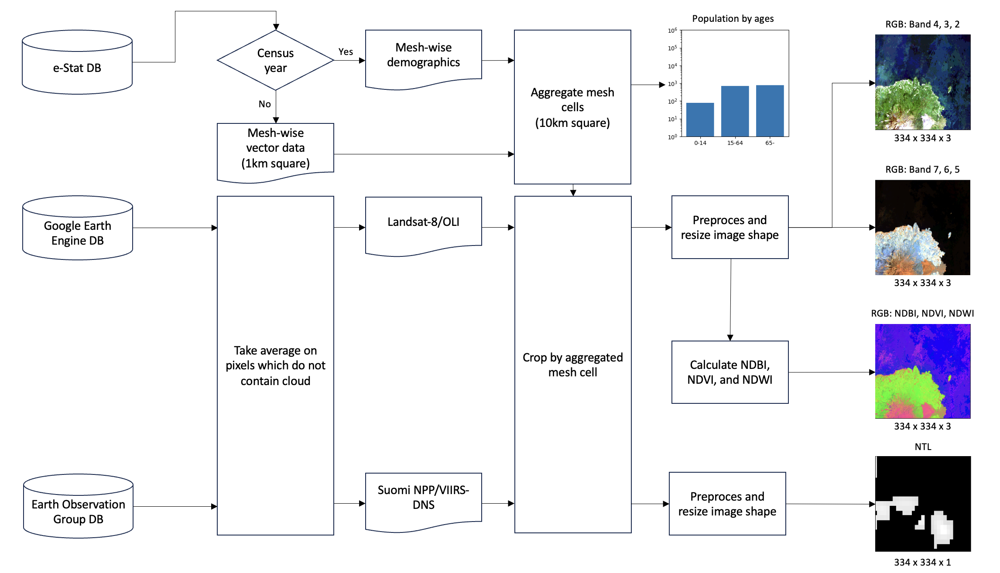

<div style='text-align: center; font-family: "Times New Roman"; font-size: 100%; line-height: 120%; max-width: 1024px;'>
<b>Figure 1.</b> Flow chart of data processing per one single sample.
</div>

<div style='text-align: justify; font-family: "Times New Roman"; font-size: 100%; line-height: 120%; max-width: 1024px;'>
Figure 1 illustrates the overview of processing images from the three data sources for the CNN model. Since satellite images are periodically collected from the space as snapshots of the Earth, it is inevitable to encounter cloud coverage in the images. To avoid the biases from cloud coverage, this paper employed adjusted images where each pixel is an annual average of those without clouds. For Landsat-8/OLI, Google Earth Engine API was used for obtaining the adjusted images of “USGS Landsat 8 Level 2, Collection 2, Tier 1” (Google, 2023). In the case of Suomi NPP/VIIRS-DNS, adjusted raster files were acquired from Annual VNL V2.1 maintained by the Earth Observation Group (Elvidge et al., 2013; Elvidge et al., 2021; Earth Observation Group, 2023). The spatial resolutions of Landsat-8/OLI and Suomi NPP/VIIRS-DNS are approximately 30m and 750m, respectively. To fulfill the gap, the pixels of Suomi NPP/VIIRS-DNS were adjusted to those from Landsat-8/OLI. Due to the coarse spatial resolution of satellite images for the size of original meshes from the census, mesh cells were firstly aggregated from 30 arc-seconds $\times$ 45 arc-seconds (1km square) to 5 arc-minutes $\times$ 7 arc-minutes and 30 arc-seconds (10km square). After the cloud coverage removal by annual averaging, two types of satellite images were cropped by the aggregated mesh cells. The cropped images were pre-processed for resizing the shape into 334 $\times$ 334 pixels square so that the following CNN model can deal with the images as inputs with 30m spatial resolution for the 10km square extent. In the pre-processing, the values of Suomi NPP/VIIRS-DNS were re-scaled with a natural logarithm. The output of this flow was the stacked images of Band 2 to 7 from Landsat-8/OLI, their synthesised three indices (NDBI, NDVI, NDWI), and the NTL from Suomi NPP/VIIRS-DNS.
</div>

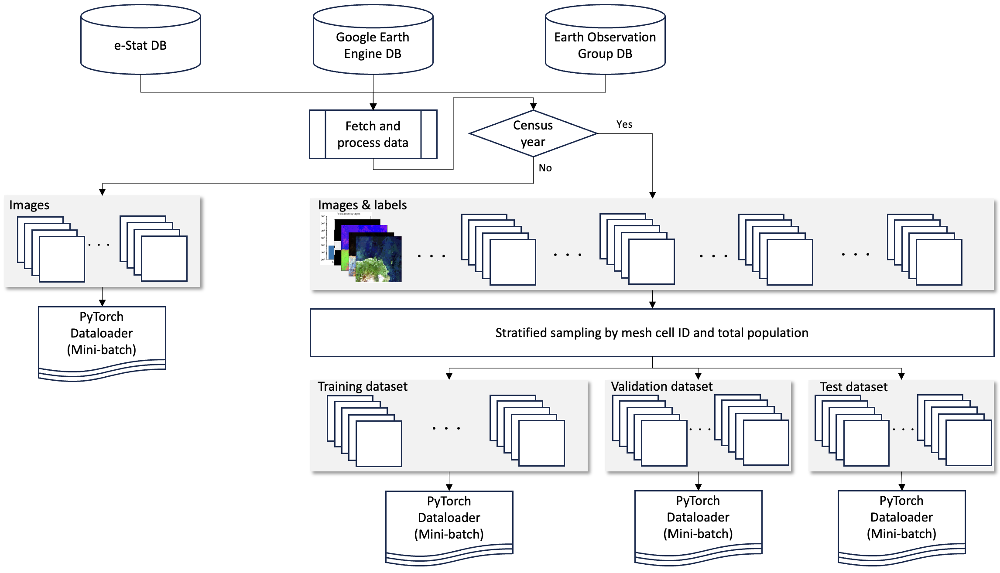

<div style='text-align: center; font-family: "Times New Roman"; font-size: 100%; line-height: 120%; max-width: 1024px;'>
<b>Figure 2.</b> Flow chart of data splitting for supervised learning.
</div>

<div style='text-align: justify; font-family: "Times New Roman"; font-size: 100%; line-height: 120%; max-width: 1024px;'>
Based on the processing per sample explained in Figure 1, Figure 2 illustrates the flow of sample management as a framework of supervised learning algorithm. In order to train a CNN model for the task of demographic composition estimation, all the processed images and labels from the census year of 2015 and 2020 were split into those for training, validation and testing. In order to ensure even distribution among the dataset groups, stratified sampling was employed by mesh cell ID and total population. In other words, unique values of strings for mesh cell IDs were extracted from all the samples, and averaged pixel values of the total population between 2015 and 2020 were obtained. It is noteworthy to mention that there was no geographical duplication between the training, validation, and testing dataset since it is already rare to observe a radical urbanisation process in Japan and geographical duplication might cause data leakage problems (Kaufman et al., 2011) in the supervised learning framework. The mesh cell IDs were assigned to 10 partitions by ten deciles of the averaged total population in the histogram. Out of the 10 partitions, samples were evenly split into training, validation, and testing with a ratio of 8:1:1. The split samples were imported to PyTorch Dataloader objects (Paszke et al., 2019) for mini-batch learning of a CNN model. Images from 2022 were directly imported to PyTorch Dataloader objects without labels.
</div>

In [1]:
# install via conda if the packages do not exist (default: comment-outed)
#!conda install -c conda-forge geopandas -y
#!conda install -c conda-forge earthengine-api -y
#!conda install -c conda-forge earthpy -y
#!conda install -c conda-forge rioxarray -y 
#!conda install pytorch torchvision torchaudio cudatoolkit=11.4 -c pytorch -y
#!conda install -c numba numba -y
#!conda install contextily -y
#!conda install matplotlib_scalebar -y
#!conda install -c conda-forge matplotlib-scalebar -y

# for general purposes
import os, sys
from glob import glob
import requests
import json
import getpass
import re
import math
import random
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.colors as colors
import matplotlib.ticker as ticker
from matplotlib_scalebar.scalebar import ScaleBar
import contextily as cx
import branca
from branca.element import MacroElement
from datetime import date, datetime
import time
from sklearn.preprocessing import MinMaxScaler
import pickle
import gc

import warnings
warnings.filterwarnings('ignore')

# for geographic data
import geopandas as gpd
import rasterio
import rasterio.plot
from rasterio.mask import mask
import rioxarray
import folium
from folium import Choropleth
from folium.plugins import DualMap
from shapely.geometry import box

# for processing Landsat
import earthpy as et
import earthpy.spatial as es
import earthpy.plot as ep
import earthpy.mask as em

# for Google Earth Engine
import ee

# for torch
import tempfile
from sklearn.model_selection import train_test_split
from sklearn.metrics import r2_score
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torchvision import models
from torch.utils.data import Dataset, DataLoader
from torch.autograd import detect_anomaly
from torch.optim.lr_scheduler import ReduceLROnPlateau

from IPython.core.display import HTML as Center

Center(""" <style>
.output_png {
    display: table-cell;
    text-align: center;
    vertical-align: middle;
}
</style> """)

def seed_everything(seed: int):
    random.seed(seed)
    os.environ['PYTHONHASHSEED'] = str(seed)
    np.random.seed(seed)
    torch.manual_seed(seed)
    torch.cuda.manual_seed(seed)
    torch.backends.cudnn.deterministic = True
    torch.backends.cudnn.benchmark = True

seed_everything(42)

device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
master_gdf = gpd.read_file('../data/census/master_gdf.gpkg')

In [2]:
torch.__version__

'2.1.0'

<h3 style='text-align: justify; font-family: "Times New Roman"; max-width: 1024px;'>
<i>Mesh cells and population census data</i>
</h3>

In [2]:
#import zipfile

#dirs = os.listdir('/Users/yutasato/Projects/LSE/GY485/data/census/population/2020_zip')
#dirs = [os.path.join('/Users/yutasato/Projects/LSE/GY485/data/census/population/2020_zip', d) for d in dirs]

#for d in dirs:
#    with zipfile.ZipFile(d, 'r') as zip_ref:
#        zip_ref.extractall('/Users/yutasato/Projects/LSE/GY485/data/census/population/2020')

<div style='text-align: justify; font-family: "Times New Roman"; font-size: 100%; line-height: 120%; max-width: 1024px;'>
First of all, the vector files of the mesh grid were obtained from e-Stat (2023), which is common throughout the sample years. Each file was named with 4-digit unique ID (i.e. 5339 for the central of Tokyo Metropolitan Area), corresponding to the ID of population census extent. In parallel, csv files of population census were also downloaded from e-Stat (2023). With the function of "get_labeled_mesh", the mesh cells were aggregated and matched with the demographic composition. Once the "year", "mesh_num" (ID of the extent), and "mesh_dir" (directory of the mesh files) were specified, aggregated table with mesh vector was stored as a GeoDataFrame object in GeoPandas, which is an extension of DataFrame in Pandas for geographic objects (Jordahl et al., 2020). For the mesh cells where there was no data was omitted from the output since it does not necessarily mean the non-existence of residents, but also implies the lack of population census (i.e. Japanese government is claiming the sovereignty of the Kuril Islands without conducting population census, since they are under effective control of Russian government).
</div>

In [3]:
def get_labeled_mesh(year: int,
                     mesh_num: int,
                     mesh_dir='../data/census/mesh'):
    """
    A function of fetching aggregated mesh with label of demographics.

    Args:
      year          : An integer indicating the mesh of census boundary.
      mesh_num      : An integer indicating the number of mesh extent.
      mesh_dir      : The directory of mesh boundary. By default, it is '../data/census/mesh'.

    Returns:
      gdf          : A GeoDataDrame object which contains vector data of aggregated mesh and demographics.    
    """

    # get the path of mesh data
    mesh_path_shp = os.path.join(mesh_dir, str(mesh_num), 'MESH0' + str(mesh_num) + '.shp')

    # import and clean up the mesh data
    gdf = gpd.read_file(mesh_path_shp)
    gdf['KEY_CODE'] = gdf['KEY_CODE'].astype(int)

    # create a dictionary for storing the prefix of file name by year
    prefix_dict = {2015: 'tblT000846S',
                   2020: 'tblT001100S'}

    # get the path of census table
    table_path = os.path.join('../data/census/population', str(year), prefix_dict[year] + str(mesh_num) + '.txt')

    # return None if there is no data available for the extent
    if not os.path.exists(table_path):
        return None

    else:
        # import and clean up the census table
        pop_df = pd.read_csv(table_path, encoding= 'unicode_escape')
        pop_df = pop_df.iloc[1:,]
        pop_df = pop_df.fillna(0).replace('*', 0)
        pop_cols = [c for c in pop_df.columns if c.startswith('T00')]
        pop_df[pop_cols] = pop_df[pop_cols].astype(float)
        pop_df['KEY_CODE'] = pop_df['KEY_CODE'].astype(int)

        # merge the mesh data with the census table
        gdf = gdf.merge(pop_df, how='left', on='KEY_CODE')

        # fulfill NA with zero
        gdf  = gdf.fillna(0)

        # identify the columns to be used
        if year==2015:
            col_list = ['T000846004', 'T000846010', 'T000846016']

        elif year==2020:
            col_list = ['T001100004', 'T001100010', 'T001100019']

        # change name of columns
        gdf[['0_14', '15_64', 'over_64']] = gdf[col_list]

        # select only relevant columns
        gdf = gdf[['MESH1_ID', 'MESH2_ID','KEY_CODE', '0_14', '15_64', 'over_64','geometry']]

        # aggregate by the id of broader extent
        gdf = gdf.dissolve(by=['MESH1_ID', 'MESH2_ID'], aggfunc='sum', numeric_only=False)

        # add a column of year
        gdf['year'] = year

        # remove tile with zero population
        gdf = gdf[np.sum(gdf[['0_14', '15_64', 'over_64']], axis=1) != 0]

        return gdf

<div style='text-align: justify; font-family: "Times New Roman"; font-size: 100%; line-height: 120%; max-width: 1024px;'>
Figure 3 visualises an example of the mesh cell aggregation being matched with the population census in the central of Tokyo Metropolitan Area in 2015, with projection by WGS 84. As seen in the aggregated ones on the right, one mesh cell in the Tokyo Bay was additionally omitted due to the lack of population in the extent.
</div>

In [52]:
year = 2015
mesh_num = 5339
mesh_dir  = '../data/census/mesh'

mesh_path_shp = os.path.join(mesh_dir, str(mesh_num), 'MESH0' + str(mesh_num) + '.shp')

gdf = gpd.read_file(mesh_path_shp)
aggregated_gdf = get_labeled_mesh(year, mesh_num)

centroid = gdf.unary_union.centroid

m = DualMap(
    tiles='cartodbpositron',
    location=[centroid.bounds[1], centroid.bounds[0]],
    zoom_start=9)

for i,row in gdf.iterrows():
    js = gpd.GeoSeries(row['geometry']).to_json()
    js = folium.GeoJson(data=js)
    js.add_to(m.m1)

for i,row in aggregated_gdf.iterrows():
    js = gpd.GeoSeries(row['geometry']).to_json()
    js = folium.GeoJson(data=js)
    js.add_to(m.m2)

m

<div style='text-align: center; font-family: "Times New Roman"; font-size: 100%; line-height: 120%; max-width: 1024px;'>
<b>Figure 3.</b> Comparison between original (left) and aggregated (right) mesh cells. The map is based on OpenStreetMap.
</div>

<div style='text-align: justify; font-family: "Times New Roman"; font-size: 100%; line-height: 120%; max-width: 1024px;'>
As seen in the output below, each row contains the polygon of aggregated mesh cell, unique identifier as "KEY_CODE", three columns of the demographic composition, and the sample year.
</div>

In [53]:
aggregated_gdf

geometry  \
MESH1_ID MESH2_ID                                                      
5339     00        POLYGON ((139.00000 35.37500, 139.00000 35.383...   
         01        POLYGON ((139.12500 35.37500, 139.12500 35.383...   
         02        POLYGON ((139.25000 35.37500, 139.25000 35.383...   
         03        POLYGON ((139.37500 35.37500, 139.37500 35.383...   
         04        POLYGON ((139.50000 35.37500, 139.50000 35.383...   
...                                                              ...   
         73        POLYGON ((139.37500 35.95833, 139.37500 35.966...   
         74        POLYGON ((139.50000 35.95833, 139.50000 35.966...   
         75        POLYGON ((139.62500 35.95833, 139.62500 35.966...   
         76        POLYGON ((139.75000 35.95833, 139.75000 35.966...   
         77        POLYGON ((139.87500 35.95833, 139.87500 35.966...   

                     KEY_CODE      0_14     15_64   over_64  year  
MESH1_ID MESH2_ID                                                  
5339     00        5339004950    1976.0   10234.0    6421.0  2015  
         01        5339014950   19265.0   92090.0   40586.0  2015  
         02        5339024950   38807.0  199634.0   80581.0  2015  
         03        5339034950   73958.0  341782.0  135764.0  2015  
         04        5339044950  106612.0  516583.0  222501.0  2015  
...                       ...       ...       ...       ...   ...  
         73        5339734950   33898.0  173955.0   74089.0  2015  
         74        5339744950   50061.0  240705.0   92791.0  2015  
         75        5339754950   51248.0  251542.0  109433.0  2015  
         76        5339764950   45178.0  216840.0  100211.0  2015  
         77        5339774950   17836.0   79109.0   28972.0  2015  

[62 rows x 6 columns]

In [5]:
master_gdf = gpd.read_file('../data/census/master_gdf.gpkg')

<div style='text-align: justify; font-family: "Times New Roman"; font-size: 100%; line-height: 120%; max-width: 1024px;'>
This process was iterated over all the mesh files and population census data from 2015 and 2020, and concatenated altogether as "master_gdf".
</div>

In [8]:
mesh_nums = os.listdir('../data/census/mesh')
mesh_nums = [n for n in mesh_nums if len(n) == 4]
mesh_dir  = '../data/census/mesh'

In [4]:
mesh_nums = os.listdir('../data/census/mesh')
mesh_nums = [n for n in mesh_nums if len(n) == 4]
mesh_dir  = '../data/census/mesh'

master_gdf = None
for year in [2015,2020]:
    for mesh_num in mesh_nums:
        gdf = get_labeled_mesh(year, mesh_num)
        master_gdf = pd.concat([master_gdf, gdf])

<div style='text-align: justify; font-family: "Times New Roman"; font-size: 100%; line-height: 120%; max-width: 1024px;'>
After the concatenation, 8,403 mesh cells were totally counted as samples from 2015 and 2020. As seen on the left in Figure 4, the distribution of the population is heavily skewed. On the other hand, the logarithm with base 10 was applied for the original number of the population, which is shown on the right in Figure 4. However, some samples contain 0 for certain demographic composition groups, where the logarithm is not defined. To avoid errors in the following computation, 0 was replaced with 1 ($10^0$) in advance.
</div>

In [5]:
print("Total number of samples : {}".format(len(master_gdf)))

Total number of samples : 8403


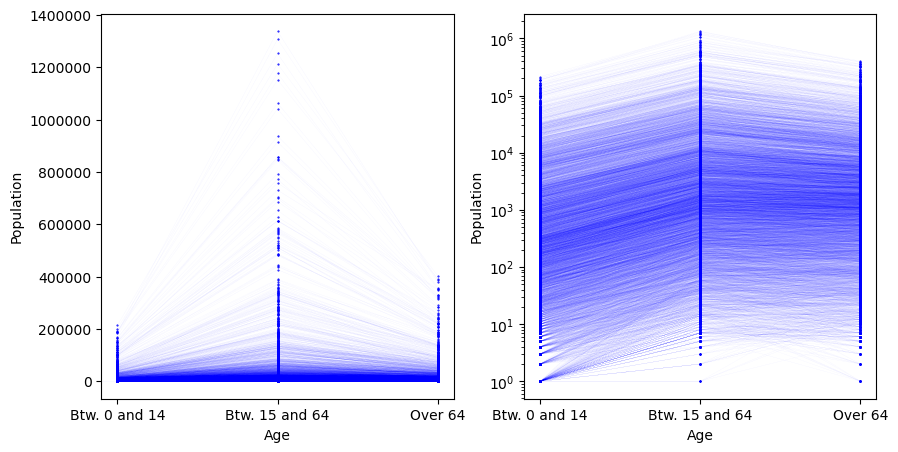

In [16]:
fig, axes = plt.subplots(1,2, figsize=(10,5))

for i in range(len(master_gdf)):
    axes[0].plot(master_gdf[['0_14', '15_64', 'over_64']].iloc[i,:], color='b', alpha=1, linewidth=.01, marker='o', markersize=.5)

for i in range(len(master_gdf)):
    axes[1].plot(master_gdf[['0_14', '15_64', 'over_64']].iloc[i,:] + 1, color='b', alpha=1, linewidth=.01, marker='o', markersize=.5)

axes[0].set_xlabel('Age')
axes[0].set_ylabel('Population')
axes[0].set_xticklabels(['Btw. 0 and 14', 'Btw. 15 and 64', 'Over 64'])
axes[0].ticklabel_format(style='plain', axis='y')

axes[1].set_xlabel('Age')
axes[1].set_ylabel('Population')
axes[1].set_xticklabels(['Btw. 0 and 14', 'Btw. 15 and 64', 'Over 64'])
axes[1].set_yscale("log")

plt.show()

<div style='text-align: center; font-family: "Times New Roman"; font-size: 100%; line-height: 120%; max-width: 1024px;'>
<b>Figure 4.</b> Distribution of population in mesh cell samples by demographic composition groups. Scales on the y-axis are original and logarithm with base 10 for the left and right figure, respectively.
</div>

<div style='text-align: justify; font-family: "Times New Roman"; font-size: 100%; line-height: 120%; max-width: 1024px;'>
Figure 5 visualises the whole unique mesh cell in the samples from 2015 and 2020. Those where population census was not conducted in either of the census years and no population was counted were omitted, which includes disputed territories such as Kuril Islands.
</div>

In [5]:
centroid = master_gdf.unary_union.centroid

m = folium.Map(
    tiles='cartodbpositron',
    location=[centroid.bounds[1], centroid.bounds[0]],
    zoom_start=5)

for i,row in master_gdf.dissolve(by=['MESH1_ID', 'MESH2_ID']).iterrows():
    js = gpd.GeoSeries(row['geometry']).to_json()
    js = folium.GeoJson(data=js)
    js.add_to(m)

m

<div style='text-align: center; font-family: "Times New Roman"; font-size: 100%; line-height: 120%; max-width: 1024px;'>
<b>Figure 5.</b> Unique mesh cells of the samples from 2015 and 2020. The map is based on OpenStreetMap.
</div>

In [53]:
master_gdf.to_file('../data/census/master_gdf.gpkg', driver='GPKG', layer='name')

<h3 style='text-align: justify; font-family: "Times New Roman"; max-width: 1024px;'>
<i>Landsat-8/OLI</i>
</h3>

<div style='text-align: justify; font-family: "Times New Roman"; font-size: 100%; line-height: 120%; max-width: 1024px;'>
Regarding Landsat-8/OLI, images were fetched via Google Earth Engine API. Before sending queries with the API, the mesh boundary was converted into an ee.Geometry.Rectangle object by a function "get_ee_mesh_boundary", so that Google Earth Engine can synthesise and crop the original images of Landsat-8/OLI.
</div>

In [17]:
def get_ee_mesh_boundary(mesh_num: int,
                         mesh_dir='../data/census/mesh') -> ee.Geometry.Rectangle:
    """
    A function of getting boundary of mesh data in a format of ee.Geometry.Rectangle

    Args:
      mesh_num       : An integer indicating the mesh of census boundary
      mesh_dir       : The directory of mesh boundary. By default, it is '../data/census/mesh'.

    Returns:
      mesh_boundary  : An object of boundary in ee.Geometry.Rectangle
    """
    # initialise Earth Engine Python API
    try:
        ee.Initialize()

    except:
        ee.Authenticate()
        ee.Initialize()

    # import the vector data of mesh
    mesh_path_shp = os.path.join(mesh_dir, str(mesh_num), 'MESH0' + str(mesh_num) + '.shp')
    gdf = gpd.read_file(mesh_path_shp)

    # get the coordinates of boundary box
    x_min = gdf.unary_union.bounds[0]
    y_min = gdf.unary_union.bounds[1]
    x_max = gdf.unary_union.bounds[2]
    y_max = gdf.unary_union.bounds[3]

    # generate a mesh boundary
    mesh_boundary = ee.Geometry.Rectangle([[x_min,y_min],[x_max, y_max]])    

    return mesh_boundary

<div style='text-align: justify; font-family: "Times New Roman"; font-size: 100%; line-height: 120%; max-width: 1024px;'>
For queries to the API, "fetch_landsat_img" was created for obtaining Landssat-8/OLI images with specified boundary and year. The inputs were the 4-digit number of mesh file, starting and ending date of the image sampling, number of bands to be fetched, path of Landsat-8 for the API, and the directory of mesh files. After initialisation of the API, the boundary of a mesh file was converted into ee.Geometry.Rectangle by "get_ee_mesh_boundary". Then, ee.ImageCollection object was initialised with date filtering specified. To remove the pixels with cloud coverage and average out the left ones, "ee.Algorithms.Landsat.simpleComposite" object was employed with integer value of the outputs. The output file was specified as GeoTIFF raster data, and the size of the minimum pixel was set as 30m. With "ee.batch.Export.image.toDrive" object, the payload was sent to Google Earth Engine and output was stored in Google Drive of the account which initialised the API.
</div>

In [18]:
def fetch_landsat_img(mesh: int,
                      start_date: str,
                      end_date: str,
                      bands: [int],
                      landsat_type='LANDSAT/LC08/C02/T1',
                      mesh_dir='../data/census/mesh'):
    """
    A function of fetching images from Landsat-8.

    Args:
      mesh         : An integer indicating the mesh of census boundary.
      start_date   : The starting date of sample in "YYYY-MM-DD" format.
      end_date     : The ending date of sample in "YYYY-MM-DD" format.
      landsat_type : The type of Landsat images. By default, Landsat-8 Collection 2 Tier 1 is selected.
      mesh_dir     : The directory of mesh boundary. By default, it is '../data/census/mesh'.

    Returns:
      task         : An ee.batch.Task object for starting the task
    """

    # initialise Earth Engine Python API
    try:
        ee.Initialize()

    except:
        ee.Authenticate()
        ee.Initialize()

    # get mesh boundary
    mesh_boundary = get_ee_mesh_boundary(mesh, mesh_dir)

    # create a collection of Landsat images
    landsat_collection = ee.ImageCollection(landsat_type).filter(ee.Filter.date(start_date, end_date))


    # create a simple composition of images (choosing least noisy pixels)
    landsat_result_img = ee.Algorithms.Landsat.simpleComposite(**{'collection': landsat_collection,
                                                                  'asFloat': False})

    # choose the band
    landsat_result_img = landsat_result_img.select(['B' + str(b) for b in bands])

    # create a payload
    payload = {'image': landsat_result_img,
               'folder': '{}'.format(start_date[:4]), # year
               'description': '{}'.format(mesh),
               'region': mesh_boundary.getInfo()['coordinates'],
               'fileFormat': 'GeoTIFF',
               'scale': 30}

    # create a task object
    task = ee.batch.Export.image.toDrive(**payload)

    return task

<div style='text-align: justify; font-family: "Times New Roman"; font-size: 100%; line-height: 120%; max-width: 1024px;'>
The function "fetch_landsat_img" was iterated over all the mesh files for each of the specified years, which consists of 2015, 2020 for developing a CNN model, and 2022 for generating estimated demographic composition. Although Band 1 was not utilised, all the seven bands were targeted for the queries.
</div>

In [10]:
for i in mesh_nums:
    task = fetch_landsat_img(mesh=i,
                         start_date='2015-01-01',
                         end_date='2015-12-31',
                         bands=[1,2,3,4,5,6,7])
    task.start()

for i in mesh_nums:
    task = fetch_landsat_img(mesh=i,
                         start_date='2020-01-01',
                         end_date='2020-12-31',
                         bands=[1,2,3,4,5,6,7])
    task.start()

for i in mesh_nums:
    task = fetch_landsat_img(mesh=i,
                         start_date='2022-01-01',
                         end_date='2022-12-31',
                         bands=[1,2,3,4,5,6,7])
    task.start()

<div style='text-align: justify; font-family: "Times New Roman"; font-size: 100%; line-height: 120%; max-width: 1024px;'>
Figure 6 shows all the seven bands of boundaries from three mesh files around Tokyo Metropolitan Area as of 2015. The grey scale plotting was done by earthpy (Wasser et al., 2019). Since the pixels were still allocated with WGS 84, the images were warped on a horizontal axis from square-shape.
</div>

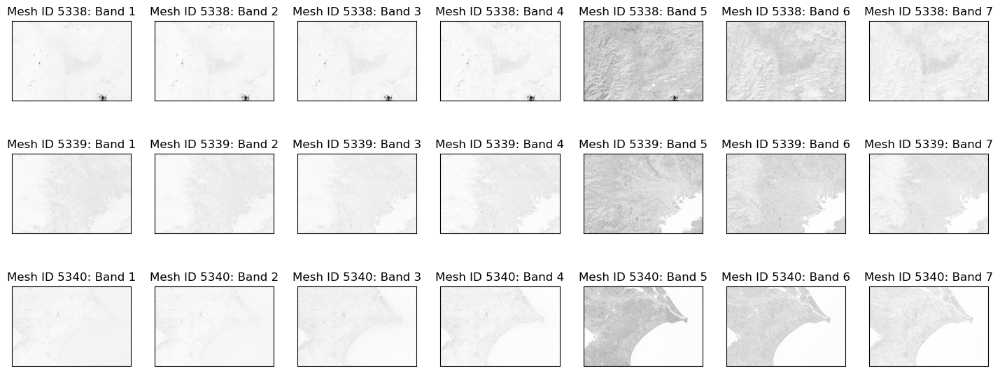

In [2]:
mesh_nums = [5338, 5339, 5340]
year = 2015

fig, axes = plt.subplots(len(mesh_nums),7, figsize=(18,7))

for mesh_i, mesh_num in enumerate(mesh_nums):
    img_lands = rasterio.open(os.path.join('../data/Landsat', str(year), str(mesh_num) + '.tif'))
    
    for ax_i,ax in enumerate(axes[mesh_i]):
        ep.plot_bands(img_lands.read(ax_i+1), cmap="binary", cbar=False, title="Mesh ID {}: Band {}".format(mesh_num, ax_i+1), ax=ax, scale=True)

plt.show()

<div style='text-align: center; font-family: "Times New Roman"; font-size: 100%; line-height: 120%; max-width: 1024px;'>
<b>Figure 6.</b> Visualised samples of Landsat-8/OLI by mesh and band from 2015.
</div>

<h3 style='text-align: justify; font-family: "Times New Roman"; max-width: 1024px;'>
<i>Suomi NPP/VIIRS-DNS</i>
</h3>

<div style='text-align: justify; font-family: "Times New Roman"; font-size: 100%; line-height: 120%; max-width: 1024px;'>
For Suomi NPP/VIIRS-DNS, annually adjusted raster files were downloaded from Earth Observation Group. By a function of "preprocess_viirs", the raster files were masked with the extent of whole the mesh files by a package rasterio (Gillies, 2023), since the original images contain all the pixels on the Earth. Then, the negative value in the cropped image was biased to zero, so that all areas without NTL were valued equally. The pixel values were followingly processed with natural logarithm, so that the unevenness of NTL was mitigated. The output was stored as a new raster file in the specified directory.
</div>

In [19]:
def preprocess_viirs(master_gdf,
                     year: int,
                     mesh_dir='../data/census/mesh',
                     ntl_dir ='../data/VIIRS/GeoTiff'):
    """
    A function of pre-processing VIIRS images.

    Args:
        master_gdf :
        year       : An integer indicating the mesh of census boundary.
        mesh_dir   : The directory of mesh boundary. By default, it is '../data/census/mesh'.
        ntl_dir    : The directory of VIIRS images. By default, it is ='../data/VIIRS/GeoTiff'.

    Returns:
        None
    """

    # import VIIRS
    img = rasterio.open(os.path.join(ntl_dir, 'original', str(year), str(year)+'.tif'))

    # mask VIIRS with master_gdf
    output, transform = mask(img, master_gdf.geometry, crop=True, all_touched=True)

    # set negative value as zero
    output = np.where(output < 0, 0, output)

    # take log
    output = np.log(output + 1e-7)

    # get the metadata
    meta = img.meta

    # update the metadata
    meta.update({"driver": "GTiff",
                 "height": output.shape[1],
                 "width": output.shape[2],
                 "transform": transform})

    # save the cropped and normalized image
    with rasterio.open(os.path.join(ntl_dir, 'processed', str(year), str(year)+'.tif'), "w", **meta) as dest:
        dest.write(output)

In [186]:
master_gdf = gpd.read_file('../data/census/master_gdf.gpkg')

<div style='text-align: justify; font-family: "Times New Roman"; font-size: 100%; line-height: 120%; max-width: 1024px;'>
This processing was iterated over the year of 2015, 2020, and 2022. The samples of the outputs were expressed by the extents of three mesh files in Tokyo Metropolitan Area in Figure 7.
</div>

In [187]:
for year in [2015,2020,2022]:
    preprocess_viirs(master_gdf, year)

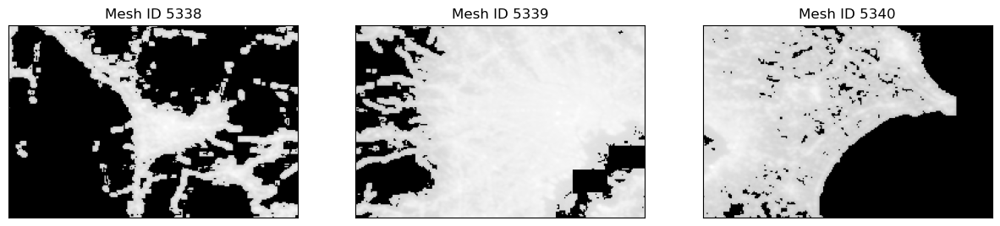

In [174]:
year = 2015
mesh_nums = [5338, 5339, 5340]
mesh_dir  = '../data/census/mesh'

fig, axes = plt.subplots(1, len(mesh_nums), figsize=(15,5))

for mesh_num, ax in zip(mesh_nums, axes):
    mesh_path_shp = os.path.join(mesh_dir, str(mesh_num), 'MESH0' + str(mesh_num) + '.shp')
    gdf = gpd.read_file(mesh_path_shp)
    
    img_viirs = rasterio.open(os.path.join('../data/VIIRS/GeoTiff/processed', str(year), str(year) + '.tif'))
    output, transform = mask(img_viirs, [gdf.unary_union], crop=True, all_touched=True, nodata=np.log(1e-7))
    ep.plot_bands(output[0,:,:], ax=ax, cbar=False, title="Mesh ID {}".format(mesh_num))

plt.show()

<div style='text-align: center; font-family: "Times New Roman"; font-size: 100%; line-height: 120%; max-width: 1024px;'>
<b>Figure 7.</b> Visualised samples of Suomi NPP/VIIRS-DNS by mesh and band from 2015.
</div>

<h3 style='text-align: justify; font-family: "Times New Roman"; max-width: 1024px;'>
<i>PyTorch Dataloader</i>
</h3>

<div style='text-align: justify; font-family: "Times New Roman"; font-size: 100%; line-height: 120%; max-width: 1024px;'>
The dataset prepared above was split into three subsets of training, validation, and testing and assembled as three PyTorch Dataloader objects. In a Pytorch Dataloader, images from Landsat-8/OLI and Suomi NPP/VIIRS-DNS were cropped and resized by "crop_images". With "KEY_CODE" as an identifier of mesh cell, all the images were cropped by the boundary of mesh cell on the projection of WGS 84 and stored in a temporary directory. Then, the cropped images were resized into 334 $\times$ 334 square and stacked as layers, given that the spatial resolution of the smallest pixel in the images was 30m from Landsat-8/OLI and the extent of the mesh cell was 10km square.
</div>

In [2]:
def crop_images(year: int,
                mesh_num: int,
                key_id: int,
                gdf,
                mesh_dir='../data/census/mesh',
                land_dir='../data/Landsat',
                ntl_dir ='../data/VIIRS/GeoTiff',
                all_dir ='../data/all_combined',
                size=224,
                mode=None
               ):
    """
    A function of cropping images with the extent of mesh.

    Args:
    year               : An integer indicating the mesh of census boundary.
    mesh_num           : An integer indicating the number of mesh extent.
    key_id             : An integer indicating the id of mesh cell.
    gdf                : An GeoDataDrame object which contains vector data of aggregated mesh and demographics.
    mesh_dir           : The directory of mesh boundary. By default, it is '../data/census/mesh'.
    land_dir           : The directory of landsat images. By default, it is '../data/Landsat'.
    ntl_dir            : The directory of VIIRS images. By default, it is '../data/VIIRS/GeoTiff'.
    all_dir            : The directory of final output. By default, it is '../data/all_combined'.
    size               : An integer of final output pixel size. By default, it is 224.
    mode               : An string indicating either 'save' or 'return' the output.

    Returns:
        stacked_layers : A np.ndarray object of stacked layers from Landsat-8 and VIIRS.
    """

    # obtain the geometry of mesh cell
    try:
        key_code = gdf.iloc[key_id]['KEY_CODE']
        geom = [gdf.geometry[key_id]]
    except:
        key_code = gdf['KEY_CODE']
        geom = [gdf.geometry]

    # create 'tmp' directory if it does not exist
    if not os.path.exists(os.path.join(all_dir, 'tmp')):
        os.mkdir(os.path.join(all_dir, 'tmp'))

    # crop Landsat-8 (Daytime image)
    with rasterio.open(os.path.join(land_dir, str(year), str(mesh_num)+'.tif')) as img_lands:
        lands_cropped, lands_transf = mask(img_lands, geom, crop=True, all_touched=True)
        lands_meta = img_lands.meta

    # update the metadata
    lands_meta.update({"driver": "GTiff",
                       "height": lands_cropped.shape[1],
                       "width": lands_cropped.shape[2],
                       "transform": lands_transf})

    # store the cropped Landsat-8/OLI
    with rasterio.open(os.path.join(all_dir, 'tmp', str(key_code) + '_landsat.tif'), "w", **lands_meta) as dest:
        dest.write(lands_cropped)

    # crop Suomi NPP/VIIRS-DNS
    with rasterio.open(os.path.join(ntl_dir, 'processed', str(year), str(year)+'.tif')) as img_viirs:
        viirs_cropped, viirs_transf = mask(img_viirs, geom, crop=True, all_touched=True)
        viirs_meta = img_viirs.meta

    # update the metadata
    viirs_meta.update({"driver": "GTiff",
                       "height": viirs_cropped.shape[1],
                       "width": viirs_cropped.shape[2],
                       "transform": viirs_transf})

    # store the cropped Suomi NPP/VIIRS-DNS
    with rasterio.open(os.path.join(all_dir, 'tmp', str(key_code) + '_viirs.tif'), "w", **viirs_meta) as dest:
        dest.write(viirs_cropped)

    # open the cropped GeoTIFF files
    xds_lands = rioxarray.open_rasterio(os.path.join(all_dir, 'tmp', str(key_code) + '_landsat.tif'))
    xds_viirs = rioxarray.open_rasterio(os.path.join(all_dir, 'tmp', str(key_code) + '_viirs.tif'))

    # reproject the Suomi NPP/VIIRS-DNS to Landsat-8/OLI for adjusting resolution
    xds_viirs = xds_viirs.rio.reproject_match(xds_lands)

    # resize pixels
    xds_viirs = xds_viirs.rio.reproject('EPSG:4326', shape=(size,size))
    xds_lands = xds_lands.rio.reproject('EPSG:4326', shape=(size,size))

    if mode == 'save':
        # save the reprojected VIIRS into GeoTIFF file
        xds_lands.rio.to_raster(os.path.join(all_dir, 'tmp', str(key_code) + '_landsat.tif'))
        xds_viirs.rio.to_raster(os.path.join(all_dir, 'tmp', str(key_code) + '_viirs.tif'))

    elif mode == 'return':
        # stack the layers into a single np.ndarray object
        stacked_layers = np.vstack([xds_lands.values, xds_viirs.values])

        # delete tmp files
        os.remove(os.path.join(all_dir, 'tmp', str(key_code) + '_landsat.tif'))
        os.remove(os.path.join(all_dir, 'tmp', str(key_code) + '_viirs.tif'))

        return stacked_layers

<div style='text-align: justify; font-family: "Times New Roman"; font-size: 100%; line-height: 120%; max-width: 1024px;'>
Out of the stacked layers, NDBI, NDVI, and NDWI were calculated and appended to the stacked layers of images by "append_index_layers" function.
</div>

In [3]:
def append_index_layers(image: np.ndarray):
    """
    A function of appending layers of three indices (NDWI, NDBI, NDVI).

    Args:
        image: A np.ndarray object containing 7 layers of Landsat-8 and 1 layer of Suomi NPP.

    Returns:
        image: A np.ndarray object which additionally contains index layers
    """

    # check whether the image has proper number of layers or not
    assert image.shape[0] == 8

    # store relevant bands
    band_3 = image[2,:,:]
    band_4 = image[3,:,:]
    band_5 = image[4,:,:]
    band_6 = image[5,:,:]

    # calculate indices
    NDBI = (band_6 - band_5) / (band_6 + band_5)
    NDVI = (band_5 - band_4) / (band_5 + band_4)
    NDWI = (band_3 - band_5) / (band_3 + band_5)

    # stack index layers
    index_layers = np.stack([NDBI,NDVI,NDWI],axis=0)

    # append index layers to the original image
    image = np.vstack([image,index_layers])

    return image

<div style='text-align: justify; font-family: "Times New Roman"; font-size: 100%; line-height: 120%; max-width: 1024px;'>
With the functions "crop_images" and "append_index_layers", a class "RemoteSensingDataset" was defined as a wrapper of "torch.utils.data.Dataset" with default pixel size of 334. Once an instance was initialised, the master of mesh cells with labels were stored. For the following computation with GPU, CUDA's availability was stored as "self.device". A Boolean "self.labels" was set. so that all the sample years could be accommodated no matter whether there were labels. The length of the object was set as the number of mesh cells. In "__getitem__" function, if "self.label" was true, cropped and resized images with NDBI, NDVI, and NDWI were fetched and converted to a "torch.tensor" object. If CUDA was available, the tensor was stored in the memory of GPU. If labels were available, the corresponding three numbers of demographic composition were firstly transformed by logarithm of base 10 with a small float number of $10^{−7}$, and all the negative values were biased to $10^0$ and converted to "torch.tensor".
</div>

In [4]:
def set_device():
    device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

    if device.type == "cpu":
        device = torch.device("mps" if torch.backends.mps.is_available() else "cpu")

    return device

In [4]:
class RemoteSensingDataset(Dataset):

    def __init__(self, master_gdf, size=224, labels=True):
        self.master_gdf = master_gdf
        self.size = size
        self.device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

        if self.device.type == "cpu":
            self.device = torch.device("mps" if torch.backends.mps.is_available() else "cpu")
            
        self.labels = labels

    def __len__(self):
        return len(self.master_gdf)

    def __getitem__(self, idx):

        # obtain the target labeled mesh cell
        gdf = self.master_gdf.iloc[idx]

        # get year and key_id
        year = gdf['year']
        mesh_num = gdf['MESH1_ID']
        key_id = gdf['KEY_CODE']

        # crop the image with the extent of labeled mesh cell and convert them into tensor
        image = crop_images(year=year, mesh_num=mesh_num, key_id=key_id, gdf=gdf, size=self.size, mode='return')
        image = append_index_layers(image)
        image = torch.tensor(image, requires_grad=True).to(self.device)

        if self.labels:
            # log based on 10 and convert them into tensor
            label = gdf[['0_14', '15_64', 'over_64']]
            label = [math.log10(value +1e-7) for value in label]
            label = np.maximum(label, 0)
            label = torch.tensor(label, requires_grad=True).float().to(self.device)
            return image, label

        else:
            return image

<div style='text-align: justify; font-family: "Times New Roman"; font-size: 100%; line-height: 120%; max-width: 1024px;'>
Before initialising "RemoteSensingDataset", the master file "master_gdf" was aggregated by a column "KEY_CODE" denoting the ID of the mesh cell, and averaged total population between 2015 and 2020 was calculated as "key_codes". This vector was partitioned by deciles as "key_deciles" and stratified sampling was conducted with a function "train_test_split" from a package scikit-learn (Pedregosa et al., 2011) with a ratio of 8:1:1 for training, validation, and testing dataset. The split mesh cells were rematched with the master file "master_gdf" and fed into "RemoteSensingDataset" class for instance initialisation. Each "RemoteSensingDataset" object was used for constructing "torch.utils.data.DataLoader" class with a batch size of 32 samples. Table 1 illustrates the descriptive statistics of samples by dataset and sample year. The spatial distribution of each dataset was visualised in Figure 8. As seen in Table 1 and Figure 8, three datasets shared a similar distribution of samples.
</div>

In [55]:
master_gdf = gpd.read_file('../data/census/master_gdf.gpkg')

master_gdf['total'] = master_gdf[['0_14', '15_64', 'over_64']].sum(axis=1)
master_gdf['pop_decile'] = pd.qcut(master_gdf['total'], 10, labels=False)
master_gdf['pop_decile_year'] = 'decile_' + master_gdf['pop_decile'].astype(str) + '_' + master_gdf['year'].astype(str)

master_gdf = master_gdf.to_crs(6691)

In [56]:
key_codes = master_gdf[['0_14', '15_64', 'over_64', 'KEY_CODE']].groupby('KEY_CODE').mean().sum(axis=1)
key_deciles = pd.qcut(key_codes, 10, labels=False)

train_key_codes, valid_key_codes = train_test_split(key_deciles, test_size=.2, random_state=1, stratify=key_deciles)
valid_key_codes, test_key_codes = train_test_split(valid_key_codes, test_size=.5, random_state=1, stratify=valid_key_codes)

train_gdf = master_gdf[master_gdf['KEY_CODE'].isin(train_key_codes.index)]
valid_gdf = master_gdf[master_gdf['KEY_CODE'].isin(valid_key_codes.index)]
test_gdf = master_gdf[master_gdf['KEY_CODE'].isin(test_key_codes.index)]

train_gdf['dataset'] = 'Training'
valid_gdf['dataset'] = 'Validation'
test_gdf['dataset'] = 'Testing'

master_gdf = pd.concat([train_gdf, valid_gdf, test_gdf])

train_dataset = RemoteSensingDataset(train_gdf, size=334)
valid_dataset = RemoteSensingDataset(valid_gdf, size=334)
test_dataset  = RemoteSensingDataset(test_gdf, size=334)

train_loader = DataLoader(train_dataset, batch_size=64, shuffle=True)
valid_loader = DataLoader(valid_dataset, batch_size=64, shuffle=False)
test_loader  = DataLoader(test_dataset,  batch_size=64, shuffle=False)

In [57]:
pd.options.display.precision = 1

counts = master_gdf[['dataset', 'year']].groupby(['dataset', 'year']).size()

means = master_gdf[['0_14', '15_64', 'over_64', 'dataset', 'year']].groupby(['dataset', 'year']).mean()
medians = master_gdf[['0_14', '15_64', 'over_64', 'dataset', 'year']].groupby(['dataset', 'year']).median()
stds = master_gdf[['0_14', '15_64', 'over_64', 'dataset', 'year']].groupby(['dataset', 'year']).std()

counts_ttl = master_gdf[['dataset', 'year']].groupby(['year']).size()

means_ttl = master_gdf[['0_14', '15_64', 'over_64', 'year']].groupby(['year']).mean()
means.loc[('Total', 2015), :] = means_ttl.loc[2015]
means.loc[('Total', 2020), :] = means_ttl.loc[2020]

medians_ttl = master_gdf[['0_14', '15_64', 'over_64', 'year']].groupby(['year']).median()
medians.loc[('Total', 2015), :] = medians_ttl.loc[2015]
medians.loc[('Total', 2020), :] = medians_ttl.loc[2020]

stds_ttl = master_gdf[['0_14', '15_64', 'over_64', 'year']].groupby(['year']).std()
stds.loc[('Total', 2015), :] = stds_ttl.loc[2015]
stds.loc[('Total', 2020), :] = stds_ttl.loc[2020]

means.columns = ['Mean (between 0 and 14 years old)','Mean (between 15 and 64 years old)','Mean (over 64 years old)']
medians.columns = ['Median (between 0 and 14 years old)','Median (between 15 and 64 years old)','Median (over 64 years old)']
stds.columns = ['Std. (between 0 and 14 years old)','Std. (between 15 and 64 years old)','Std. (over 64 years old)']

summary = pd.concat([means,medians,stds], axis=1)
summary['Counts'] = master_gdf[['dataset', 'year']].groupby(['dataset', 'year']).size()
summary = summary.iloc[:,[9,0,3,6,1,4,7,2,5,8]]
summary = summary.iloc[[2,3,4,5,0,1,6,7],:]

summary.iloc[6:8,0] = counts_ttl

In [58]:
summary.style.set_caption("<b>Table 1.</b> A summary of descriptive statistics of samples by dataset and sample year.\n").format("{:.4f}") 

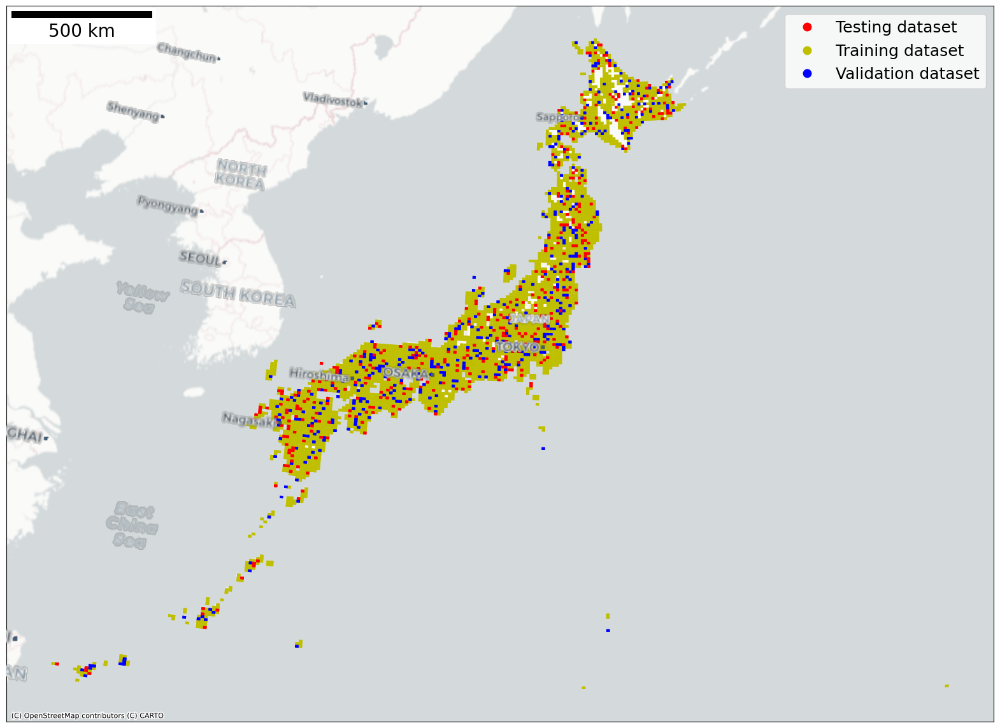

In [233]:
train_gdf['type'] = 'Training dataset'
valid_gdf['type'] = 'Validation dataset'
test_gdf['type']  = 'Testing dataset'

master_gdf = pd.concat([train_gdf, valid_gdf, test_gdf])

fig, ax = plt.subplots(1,1,figsize=(20,20))

master_gdf.plot(column='type',
                cmap=colors.ListedColormap(['r','y','b']),
                legend=True,
                alpha=1,
                ax=ax)

ax.set_xticks([])
ax.set_yticks([])
cx.add_basemap(ax, source=cx.providers.CartoDB.PositronNoLabels, crs=master_gdf.crs, zoom=5)
cx.add_basemap(ax, source=cx.providers.CartoDB.PositronOnlyLabels, crs=master_gdf.crs, zoom=5)

ax.add_artist(ScaleBar(
    dx=1,
    location="upper left"))

ax.arrow(0, 0, 0, 1, length_includes_head=True,
          head_width=0.8, head_length=1.5, overhang=.1, facecolor='k') # North Arrow

plt.rcParams.update({'font.size': 20})
plt.rc('legend', fontsize=18)

<div style='text-align: center; font-family: "Times New Roman"; font-size: 100%; line-height: 120%; max-width: 1024px;'>
<b>Figure 8.</b> Spatial distribution of training, validation, and testing dataset by two census years. JGD2011 was applied for the coordinate reference system. The map is based on OpenStreetMap.
</div>

<div style='text-align: justify; font-family: "Times New Roman"; font-size: 100%; line-height: 120%; max-width: 1024px;'>
A function "visualise_img" was developed to visualise the images and labels in the training dataset. Figure 9 shows five randomly sampled images and labels. As seen in the figure, the images with RGB of Band 4, 3, and 2 were close to natural colour, while those with Band 7, 6, 5 and NDBI, NDVI, and NDWI were expressed in false colour. The combination of NDBI, NDVI, and NDWI could explicitly delineate water, forest, and the others. NTL from Suomi NPP/VIIRS-DNS highlighted the location of human activities at night.
</div>

In [8]:
def visualise_img(features, labels, figsize=10, fig_num=1):
    """
    A function of vilusalising relevant images as samples.
    Args:
        features
        labels
        figsize
        fig_num

    Returns:
        None
    """

    fig, axes = plt.subplots(fig_num, 5, figsize=(figsize, figsize))
    plt.rcParams.update({'font.size': 9})

    for i, ax in enumerate(axes):

        image = features[i]
        label = labels[i]

        # convert tensor into numpy.ndarray
        if isinstance(image, torch.Tensor):
            image = image.cpu().detach().numpy() 

        if isinstance(label, torch.Tensor):
            label = label.cpu().detach().numpy()

        # plot landsat with band 4, 3, 2 for RGB
        ep.plot_rgb(image, rgb=(3, 2, 1), stretch=True, ax=ax[0])
        ax[0].set_title('RGB: Band 4, 3, 2')

        # plot landsat with band 7, 6, 5 for RGB
        ep.plot_rgb(image, rgb=(6, 5, 4), stretch=True, ax=ax[1])
        ax[1].set_title('RGB: Band 7, 6, 5')

        # plot landsat with NDVI
        ep.plot_rgb(image, rgb=(-3, -2, -1), stretch=True, ax=ax[2])
        ax[2].set_title('RGB: NDBI,NDVI,NDWI')
        ax[2].set_xticks([])
        ax[2].set_yticks([])

        # plot VIIRS
        ax[3].imshow(image[7,:,:], cmap='gray')
        ax[3].set_title('NTL')
        ax[3].set_xticks([])
        ax[3].set_yticks([])

        # plot label
        ax[4].bar(x=['0-14', '15-64', '65-'], height=10**label)
        ax[4].set_title('Population by ages')
        ax[4].set_xticklabels(['Btw. 0-14', 'Btw. 15-64', 'Over 64'])
        ax[4].set_yscale("log") 
        ax[4].set_ylim(10**0,10**6)

    plt.show()

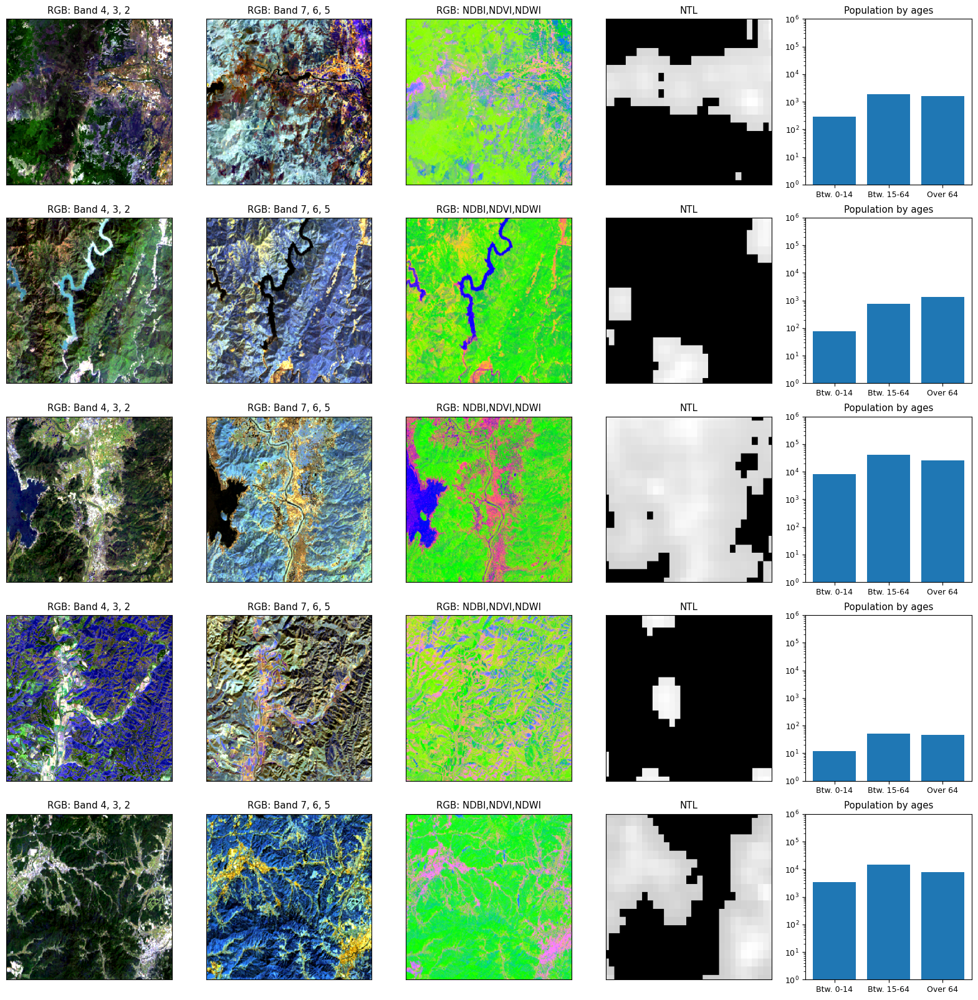

In [34]:
torch.manual_seed(1)

train_features, train_labels = next(iter(train_loader))

visualise_img(train_features, train_labels, figsize=20, fig_num=5)

<div style='text-align: center; font-family: "Times New Roman"; font-size: 100%; line-height: 120%; max-width: 1024px;'>
<b>Figure 9.</b> Images and labels from five random samples from the training dataset.
</div>

<h2 style='text-align: justify; font-family: "Times New Roman"; max-width: 1024px;'>
4. Methodology
</h2>

<h3 style='text-align: justify; font-family: "Times New Roman"; max-width: 1024px;'>
<i>Deep Learning architecture</i>
</h3>

<div style='text-align: justify; font-family: "Times New Roman"; font-size: 100%; line-height: 120%; max-width: 1024px;'>
Let the CNN model $f:= \mathcal{X} \to \mathcal{Y}$, where $\mathcal{X}:= \{\mathbf{X}_i | \mathbf{X}_i  \in \mathbb{R}^{334 \times 334 \times 12} \}$ a feature tensor space consisting of four types of RGB-based images and $\mathcal{Y}:= \{\mathbf{y}_i | \mathbf{y}_i \in \mathbb{R}^{3} \}$ a label vector space consisting of three number of demographic composition groups. Then, the predicted demographic composition vector $\hat{\mathbf{y}}_{it} \in \mathbb{R}^{3}$ is expressed as following:
</div>

$$
\hat{\mathbf{y}}_{it} = f(\mathbf{X}_i; \boldsymbol \Theta_t)
$$

<div style='text-align: justify; font-family: "Times New Roman"; font-size: 100%; line-height: 120%; max-width: 1024px;'>
where $\boldsymbol \Theta_t$ is an element of $\boldsymbol \Theta$ as a set of layer weights in $f$ such that $\boldsymbol \Theta = \{\boldsymbol \Theta_t \}$ and $t \in \mathbb{N}$ denotes the order of training. The CNN model $f$ will be trained through the gradient descent method as backpropagation such that
</div>

$$
\boldsymbol \theta^{l}_{t} = \boldsymbol \theta^{l}_{t-1} - \text{Optim}(\alpha, \nabla \boldsymbol \theta^{l}_{t-1})
$$

$$
\nabla \boldsymbol \theta^{l}_{t-1} = \frac{\partial \mathcal{L}(\hat{\mathbf{y}}_{it-1}, \mathbf{y}_i)}{\partial \boldsymbol \theta^{l}_{t-1}}
$$

<div style='text-align: justify; font-family: "Times New Roman"; font-size: 100%; line-height: 120%; max-width: 1024px;'>
where $\boldsymbol \theta^{l}_{t} \in  \boldsymbol \Theta_{t}$ and $\text{Optim}(\alpha, \nabla \theta^{l}_{t})$ denote the $l$-th layer of $\boldsymbol \Theta_{t}$ and the optimiser with the learning rate $\alpha \in \mathbb{R}^{+}$ and gradient $\nabla \theta^{l}_{t}$, respectively. For the loss function $\mathcal{L}(\hat{\mathbf{y}}_{it}, \mathbf{y}_i)$, this paper adopts the formula of following:
</div>

$$\mathcal{L}(\hat{\mathbf{y}}_{it}, \mathbf{y}_i) = \frac{1}{N} \sum_{i}^{N} \lvert \lvert \hat{\mathbf{y}}_{it} - \mathbf{y}_i \rvert \rvert $$


<div style='text-align: justify; font-family: "Times New Roman"; font-size: 100%; line-height: 120%; max-width: 1024px;'>
For the optimiser, Adam (Kingma and Ba, 2017) is applied with following:
</div>


$$
\text{Optim}(\alpha, \nabla \boldsymbol \theta^{l}_{t}; \beta_1, \beta_2) = \alpha \frac{\hat{m}_t}{\sqrt{\hat{v}_t + \epsilon}} \nabla \boldsymbol \theta^{l}_{t-1}
$$

$$
m_{t} = \beta_1 m_{t-1} - (1 - \beta_1) \nabla \boldsymbol \theta^{l}_{t-1}
$$

$$
v_{t} = \beta_2 v_{t-1} - (1 - \beta_2) (\nabla \boldsymbol \theta^{l}_{t-1})^2
$$

$$
\hat{m}_{t} = \frac{m_{t}}{1 - \beta_1^t}
$$

$$
\hat{v}_{t} = \frac{v_{t}}{1 - \beta_2^t}
$$

<div style='text-align: justify; font-family: "Times New Roman"; font-size: 100%; line-height: 120%; max-width: 1024px;'>
where $\beta_1$ and $\beta_2$ denote the hyperparameters of the first and second moment vectors. After every training of all samples in the training dataset as one epoch, the trained CNN model $f$ will be validated with samples in the validation dataset by calculating $\mathcal{L}$. This one cycle of training and validation will be iterated over 250 epochs, and a model with the least validation error will be selected as the best model in terms of generalisability. The chosen best model was tested by samples in the testing dataset and $R^2$ will be calculated for each demographic composition group $g$ as follows:
</div>

$$
R^{2}_{(g)} = \frac{\sum (\hat{y}_i^{(g)} - \bar{y}_i^{(g)})^2}{\sum (y_i^{(g)} - \bar{y}_i^{(g)})^2}
$$

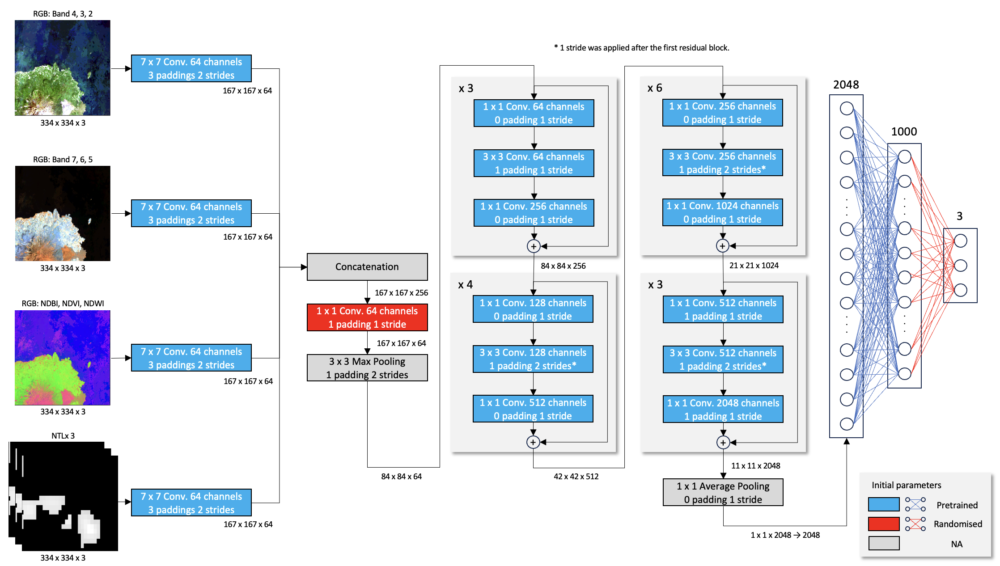

<div style='text-align: center; font-family: "Times New Roman"; font-size: 100%; line-height: 120%; max-width: 1024px;'>
<b>Figure 10.</b> Architecture of ResNet50-based CNN model.
</div>

<div style='text-align: justify; font-family: "Times New Roman"; font-size: 100%; line-height: 120%; max-width: 1024px;'>
Figure 10 displays the architecture of the CNN model $f$. The model employed multi-head CNN based on ResNet50 (He et al., 2016), so that multi-layered images could be processed as multiple RGB-coloured tensors. Four images were set as inputs of RGB-coloured tensors, where NTL was duplicately stacked for each colour. These inputs were passed through the first convolution layer and concatenated along the dimension of channels. The concatenated tensor was convoluted with 1 $\times$ 1 filter and aggregated by max pooling layer for down-sizing, which only keeps a maximum value in the window. The pooled tensor was further convoluted 48 times with skip connections. The output from all the convolutions was pooled by 1 $\times$ 1 average pooling layer as an operation of taking an average in the window, leading to 1 $\times$ 1 $\times$ 2048 tensor. The tensor was flattened to a 2048-dimension vector and passed through two fully-connected layers with the final output of a 3-dimension vector $\hat{\mathbf{y}}_{it}$, estimating the demographic composition in the sample. The output size of each convolution and pooling layer was described in Figure 10 by the formula of following:
</div>

$$
n_{out} = \lfloor \frac{n_{in} + 2p - k}{s} \rfloor + 1
$$

<div style='text-align: justify; font-family: "Times New Roman"; font-size: 100%; line-height: 120%; max-width: 1024px;'>
where $n_{in}$ and $ n_{out}$ denote the size of input and output, respectively. $p$, $k$, and $s$ stand for the size of zero-padding, filter, and strides, respectively.  $\lfloor . \rfloor$ operation indicates obtaining an integer number from the float number. For instance, the output size of the first convolution for Landsat-8/OLI Band 4,3, and 2 was $\lfloor \frac{334 + 2*3 - 7}{2} \rfloor + 1 = 167$. As shown in Figure 10, all the parameters of this CNN model were transferred from ResNet50 being pretrained by the ImageNet dataset, except the second convolution layer and the last fully-connected layer. Moreover, batch normalisation was implemented after each of the convolution layers, where each batch in the forward propagation was normalised with the average and variance, so that the training process could be stabilised (Ioffe and Szegedy, 2015). $\text{ReLU}$ was used as an activation function for all the convolution layers after batch normalisation. In addition to batch normalisation, dropout (Krizhevsky et al., 2012) was implemented for avoiding overfitting. Dropout is an operation for removing a certain amount of neurons within a layer during training so that the CNN model would be robust to the heterogeneity in the dataset as if it behaves as ensemble learning. However, as Li et al. (2019) reported, the co-existence of dropout and batch normalisation in the convolution layer would worsen the performance of CNN models due to variance shifts. Thus, dropout was applied only to the last two fully-connected layers, where batch normalisation was not implemented in the original ResNet50. Since all the labels were biased to $10^0$ and their values were always non-negative, the last layer was also passed through $\text{ReLU}$. For the hyperparameters of this machine learning framework, the learning rate $\alpha$ and coefficients of the first and second moment $\beta_1$ and $\beta_2$ for Adam were set as 0.001, 0.9, and 0.999, respectively. The ratio of dropout was set as 0.25 for both of the two fully-connected layers. As an environment of model training, AWS Sagemaker Studio was used with an instance type of g4dn.xlarge consisting of 4 vCPUs, 16 GB memory, and 1 GPU of NVIDIA Tesla T4 (AWS, 2023).
</div>

<div style='text-align: justify; font-family: "Times New Roman"; font-size: 100%; line-height: 120%; max-width: 1024px;'>
A class "RemoteSensingCNN" was defined as a wrapper of "nn.Module" class for the designed CNN model. In "__init__", all the necessary parameters were initialised, including the type of computation ("self.device"), first convolution layer ("self.conv_band2_4", "self.conv_band5_7", "self.conv_viirs", and "self.conv_indices"), batch normalisation for all convoluted inputs ("self.bn_band2_4", "self.bn_band5_7", "self.bn_viirs", and "self.bn_indices"), 1 $\times$ 1 convolution layer after concatenation ("self.conv_all"), pretrained ResNet50 ("self.resnet"), and the last fully-connected layer ("self.fc2"). All the parameters of the first convolution layer were transferred from "self.resnet.conv1", which is the original first convolution layer in ResNet50. In "forward' method, forward propagation was defined as the design mentioned in Figure 10. Since this class was established on "nn.Module", back propagation was automatically calculated by "autograd" function in PyTorch (Paszke et al., 2019).
</div>

In [15]:
class RemoteSensingCNN(nn.Module):
    """
    A class of CNN model with transfer learning from ResNet50.
    """

    def __init__(self, out_dim, pretrained):
        super(RemoteSensingCNN, self).__init__()
        self.device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

        if self.device.type == "cpu":
            self.device = torch.device("mps" if torch.backends.mps.is_available() else "cpu")

        self.conv_band2_4 = nn.Conv2d(
            in_channels=3,
            out_channels=64,
            kernel_size=7,
            stride=2,
            padding=3,
            bias=False,
        )
        self.conv_band5_7 = nn.Conv2d(
            in_channels=3,
            out_channels=64,
            kernel_size=7,
            stride=2,
            padding=3,
            bias=False,
        )

        self.bn_band2_4 = nn.BatchNorm2d(64)
        self.bn_band5_7 = nn.BatchNorm2d(64)
        self.conv_all = nn.Conv2d(
            in_channels=64 + 64, out_channels=64, kernel_size=1, bias=False
        )
        self.resnet = models.resnet50(pretrained=pretrained).to(self.device)
        self.fc2 = nn.Linear(1000, out_dim)
        self.dropout = nn.Dropout(0.25)

        self.conv_band2_4.load_state_dict(self.resnet.conv1.state_dict())
        self.conv_band5_7.load_state_dict(self.resnet.conv1.state_dict())

    def forward(self, x):
        band2_4 = x[:, 2 - 1 : 4, :, :].flip(dims=[0])
        band5_7 = x[:, 5 - 1 : 7, :, :].flip(dims=[0])

        band2_4 = self.conv_band2_4(band2_4)
        band5_7 = self.conv_band5_7(band5_7)

        band2_4 = F.relu(self.bn_band2_4(band2_4))
        band5_7 = F.relu(self.bn_band5_7(band5_7))

        x = torch.cat((band2_4, band5_7), dim=1)
        x = self.conv_all(x)
        x = self.resnet.bn1(x)
        x = self.resnet.relu(x)
        x = self.resnet.maxpool(x)
        x = self.resnet.layer1(x)
        x = self.resnet.layer2(x)
        x = self.resnet.layer3(x)
        x = self.resnet.layer4(x)
        x = self.resnet.avgpool(x)
        x = x.view(x.size(0), -1)
        x = self.dropout(x)
        x = F.relu(self.resnet.fc(x))
        x = self.dropout(x)
        x = F.relu(self.fc2(x))

        return x


<div style='text-align: justify; font-family: "Times New Roman"; font-size: 100%; line-height: 120%; max-width: 1024px;'>
A function "train" was developed for managing all the procedures required in the training and validation phase. Firstly, the availability of GPU was specified. Since the computation could be intermitted due to the long training process of the CNN model, the latest progress was imported in advance. If the training was initialised from scratch, a dictionary for storing the training and validation loss was created, as well as a variable for storing the best loss. As a loss function, mean squared error (MSE) was used before taking a root. For optimiser, Adam was selected with the hyperparameters. "model" was imported to the memory of either CPU or GPU. Then, the training process was iterated over the number of epochs. Within each epoch, a manual seed was set with the number of epochs for ensuring the reproductivity of randomness such as shuffling the samples for forming batches. After skipping completed epochs, the CNN model was trained by batches. The images and labels were imported on the memory of CPU or GPU and previous gradients were refreshed, and output was obtained after forward propagation. The output was used to calculate the loss function with the labels, and backpropagation was executed to update parameters. The calculated loss was temporarily stored, and all the training loss in the epoch was averaged and stored in the created dictionary. After finishing the epoch for training, the validation dataset was used to calculate and store validation loss in the same manner as the forward propagation of the training dataset. If the validation loss was the least among the past records, the model was saved as "best_model". The trained model in the epoch was separately stored as "latest_model" as well.
</div>

In [16]:
def train(model,
          train_loader: torch.utils.data.dataloader.DataLoader,
          valid_loader: torch.utils.data.dataloader.DataLoader,
          epochs: int,
          early_stopping: int,
          record_path='../src/pretrained/record_dict_pkl',
          latest_path='../src/pretrained/latest_model',
          best_path='../src/pretrained/best_model'):
    """
    A function of managing the training of CNN model at once.

    Args:
       model           : An object of RemoteSensingCNN.
       train_loader    : A torch.utils.data.dataloader.DataLoader object for training dataset.
       valid_loader    : A torch.utils.data.dataloader.DataLoader object for validation dataset.
       epochs          : An integer which specifies the number of total epoches.
       early_stopping  : An integer which spcefifies the torrelance of early stopping.
       record_path     : By default, it is '../src/pretrained/record_dict_pkl'.
       latest_path     : By default, it is '../src/pretrained/latest_model'.
       best_path       : By default, it is '../src/pretrained/best_model'.

    Returns:
        None
    """

    # store a string of availability of GPU
    device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

    if device.type == "cpu":
        device = torch.device("mps" if torch.backends.mps.is_available() else "cpu")

    # if there is already a recorded file, import it together with the latest model
    if os.path.exists(record_path):
        with open(record_path, 'rb') as f:
            record_dict = pickle.load(f)
        best_loss = min([v['valid_loss'] for v in record_dict.values()])
        model.load_state_dict(torch.load(latest_path, map_location=torch.device(device)))

    # initiate the record dictornary and best loss as positive infinite
    else:
        record_dict = {}
        best_loss = np.inf

    # initialise a loss function object (MSE)
    criterion = nn.MSELoss()

    # initialise an optimiser object (Adam)
    optimizer = optim.Adam(model.parameters(), lr=0.001)

    # set CPU or GPU
    model = model.to(device)

    # initialise a variable for early stopping
    not_improving = 0

    # iterate over epochs
    for epoch in range(epochs):

        # set seed by epoch
        torch.manual_seed(epoch)

        # skip completed epoches 
        if epoch in record_dict.keys():
            continue

        # change mode as training
        model.train(True)

        # initialise a list for training loss
        train_loss = []

        for i, (img, label) in enumerate(train_loader):

            with detect_anomaly():

                # convert images and labels to either CPU tensor or GPU tensor
                img, label = img.to(device), label.to(device)

                # clean up the gradient
                optimizer.zero_grad()

                # execute forward propagation
                output = model(img)

                # if the output is NaN, skip back propagation
                if torch.isnan(output).any():
                    print(f'[epoch {epoch + 1},{i + 1:3d}] loss: skipped due to nan')

                else:
                    # calculate RMSE of logged labels
                    loss = torch.sqrt(criterion(label, output))

                    # execute back propagation
                    loss.backward()
                    optimizer.step()

                    # store the training loss of this iteration
                    train_loss.append(loss.item())

                    print(f'[epoch {epoch + 1},{i + 1:3d}] loss: {loss.item():.3f}')

        # calculate mean of the training loss
        train_loss = np.mean(train_loss)

        # release memory on GPU
        if device == 'cuda:0' or device.type == "mps":
            gc.collect()
            torch.cuda.empty_cache()

        # change mode as validation
        model.eval()

        # initialise a list for validation loss
        valid_loss = []
        #with torch.no_grad():
        for i, (img, label) in enumerate(valid_loader):
            with detect_anomaly():

                # convert images and labels to either CPU tensor or GPU tensor
                img, label = img.to(device), label.to(device)

                # execute forward propagation
                output = model(img)

                # calculate RMSE of logged labels
                loss = torch.sqrt(criterion(label, output))

                # store the validation loss of this iteration
                valid_loss.append(loss.item())

        # calculate mean of the validation loss
        valid_loss = np.mean(valid_loss)

        # if the validation loss is the best so far, store it as best_loss and save the model
        if valid_loss < best_loss:
            best_loss  = valid_loss
            torch.save(model.state_dict(), best_path)
            not_improving = 0
        else:
            not_improving += 1

        # update the record dictionary
        record_dict.update({epoch:
                            {'train_loss': train_loss,
                             'valid_loss': valid_loss}})

        print(f'[epoch {epoch + 1}] train_loss: {train_loss:.3f}, valid_loss: {valid_loss:.3f}')

        # save record_dict as pickle
        with open(record_path, 'wb') as f:
            pickle.dump(record_dict, f)

        # save the latest model
        torch.save(model.state_dict(), latest_path)

        if not_improving == early_stopping:
            print("Early Stopping...")
            break

<div style='text-align: justify; font-family: "Times New Roman"; font-size: 100%; line-height: 120%; max-width: 1024px;'>
With the created class "RemoteSensingCNN" and function "train", the CNN model was trained and validated over 250 epochs.
</div>

In [17]:
remote_sensing_cnn = RemoteSensingCNN(out_dim=3, pretrained=True)

key_codes = master_gdf[['0_14', '15_64', 'over_64', 'KEY_CODE']].groupby('KEY_CODE').mean().sum(axis=1)
key_deciles = pd.qcut(key_codes, 10, labels=False)

train_key_codes, valid_key_codes = train_test_split(key_deciles, test_size=.2, random_state=1, stratify=key_deciles)
valid_key_codes, test_key_codes = train_test_split(valid_key_codes, test_size=.5, random_state=1, stratify=valid_key_codes)

train_gdf = master_gdf[master_gdf['KEY_CODE'].isin(train_key_codes.index)]
valid_gdf = master_gdf[master_gdf['KEY_CODE'].isin(valid_key_codes.index)]
test_gdf = master_gdf[master_gdf['KEY_CODE'].isin(test_key_codes.index)]

train_dataset = RemoteSensingDataset(train_gdf, size=334)
valid_dataset = RemoteSensingDataset(valid_gdf, size=334)
test_dataset  = RemoteSensingDataset(test_gdf, size=334)

train_loader = DataLoader(train_dataset, batch_size=32, shuffle=True)
valid_loader = DataLoader(valid_dataset, batch_size=32, shuffle=False)
test_loader  = DataLoader(test_dataset,  batch_size=32, shuffle=False)

train(remote_sensing_cnn, train_loader, valid_loader, epochs=3, early_stopping=30)

NameError: name 'set_device' is not defined

<h2 style='text-align: justify; font-family: "Times New Roman"; max-width: 1024px;'>
5. Result
</h2>

<h3 style='text-align: justify; font-family: "Times New Roman"; max-width: 1024px;'>
<i>Result of training and validation</i>
</h3>

In [3]:
with open('../src/pretrained/outputs.pth', 'rb') as p:
    outputs = pickle.load(p)

test_loss = 0.3214581294192208

<div style='text-align: justify; font-family: "Times New Roman"; font-size: 100%; line-height: 120%; max-width: 1024px;'>
As a result of the training and validation process, Figure 11 illustrates the training and validation loss function over 250 epochs. In the early epochs, the validation loss function had a volatility of up to 1.22. While the training loss was steadily decreased throughout the epochs, validation loss reached its lower bound of 0.35 at around the epoch 50 and little improvement was observed in the following epochs. The training loss recorded 0.3186 as the minima at epoch 238, and the model at the epoch was employed as the one with the most generalisability for the testing and dataset generation.
</div>

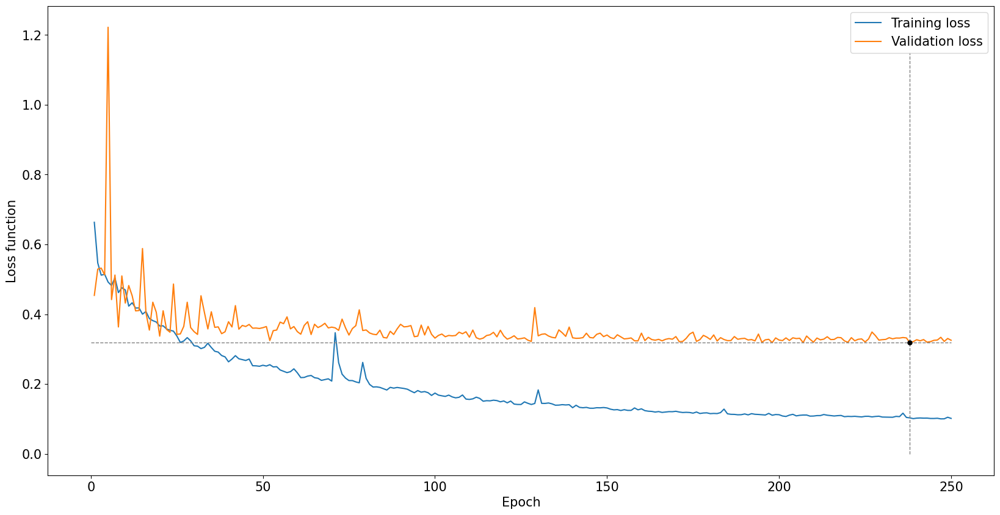

In [319]:
with open('../src/pretrained/record_dict_pkl', 'rb') as f:
    record_dict = pickle.load(f)

records = pd.DataFrame(record_dict).transpose()

plt.rcParams.update({'font.size': 15})
plt.rc('legend', fontsize=15)

fig, ax = plt.subplots(figsize=(20,10))

ax.plot([i+1 for i in records.index], records['train_loss'])
ax.plot([i+1 for i in records.index], records['valid_loss'])

ax.vlines(np.argmin(records['valid_loss'])+1,0,1.15, linestyle="dashed", color='grey', linewidth=1)
ax.hlines(np.min(records['valid_loss']),0,250, linestyle="dashed", color='grey', linewidth=1)
ax.plot(np.argmin(records['valid_loss'])+1,np.min(records['valid_loss']), '.' ,markersize=10, color='black')

ax.legend(['Training loss', 'Validation loss'])

ax.set_xlabel("Epoch")
ax.set_ylabel("Loss function")

plt.show()

<div style='text-align: center; font-family: "Times New Roman"; font-size: 100%; line-height: 120%; max-width: 1024px;'>
<b>Figure 11.</b> Training and validation progress of the CNN model. The grey horizontal and vertical dotted lines indicate the lowest value of the loss function in the validation dataset throughout the epochs and its epoch, respectively. The intersection of the dotted lines indicate the loss function of the validation dataset at epoch 238.
</div>

In [356]:
print("The best validation score was recorded by the model with loss function of {:.4f} at epoch {}."
      .format(np.min(records['valid_loss']),
              np.argmin(records['valid_loss'])+1))

print("The loss function in the training dataset was {:.4f} at epoch {}."
      .format(records.iloc[np.argmin(records['valid_loss']), 0],
              np.argmin(records['valid_loss'])+1))

The best validation score was recorded by the model with loss function of 0.3186 at epoch 238.
The loss function in the training dataset was 0.1032 at epoch 238.


<h3 style='text-align: justify; font-family: "Times New Roman"; max-width: 1024px;'>
<i>Result of testing</i>
</h3>

In [23]:
test_gdf = gpd.read_file('../data/census/test_gdf.gpkg')

<div style='text-align: justify; font-family: "Times New Roman"; font-size: 100%; line-height: 120%; max-width: 1024px;'>
With the trained model chosen above, the testing dataset was utilised for calculating the testing score in $R^2_{(G)}$, as well as the loss function. To do so, all the images in the testing dataset were passed through the CNN model as forward propagation, and outputs were used for calculating loss function as test error. The outputs were stored in an object "outputs". As a result, the test error was 0.3215, which was close to the one in the validation dataset.</div>

In [580]:
# create an instance of a CNN model
remote_sensing_cnn = RemoteSensingCNN(out_dim=3, pretrained=True)

# change mode as validation
remote_sensing_cnn.eval()

# store a string of availability of GPU
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

# initialise a loss function object (MSE)
criterion = nn.MSELoss()

# initialise a list for test loss
test_loss = []

with torch.no_grad():
    for i, (img, label) in enumerate(test_loader):
        with detect_anomaly():

            # convert images and labels to either CPU tensor or GPU tensor
            img, label = img.to(device), label.to(device)

            # execute forward propagation
            output = remote_sensing_cnn(img)

            # calculate RMSE of logged labels
            loss = torch.sqrt(criterion(label, output))

            # store the test loss of this iteration
            test_loss.append(loss.item())

# calculate mean of the test loss
test_loss = np.mean(test_loss)

In [357]:
print("The loss function in the testing dataset was {:.4f}."
      .format(test_loss))

The loss function in the testing dataset was 0.3215.


<div style='text-align: justify; font-family: "Times New Roman"; font-size: 100%; line-height: 120%; max-width: 1024px;'>
For the calculation of $R^2_{(g)}$, a function calc_r2_score was developed to construct a pipeline. $R^2_{(g)}$ was calculated by this function for the testing dataset, as well as the training and validation dataset as references, which were summarised in Table 2.</div>

In [59]:
def calc_r2_score(model,
                  d_loader: torch.utils.data.dataloader.DataLoader,
                  gdf):
    """
    A function to calculate R^2 for all the demographic composition groups.

    Args:
       model           : An object of RemoteSensingCNN.
       d_loader        : A torch.utils.data.dataloader.DataLoader object.
       gdf             : An GeoDataDrame object which contains vector data of aggregated mesh and demographics.

    Returns:
        r2_scores      : A list which stores the R^2 for all the demographic composition groups.
    """
    # set device
    device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
    device = torch.device("mps" if torch.backends.mps.is_available() else "cpu")

    # import the parameters of the best model
    remote_sensing_cnn.load_state_dict(torch.load('../src/pretrained/best_model', map_location=torch.device(device)))

    # set device
    remote_sensing_cnn.to(device)

    # set as evaluation mode
    model.eval()

    # initialise a list to store the output
    outputs = []

    # set seed
    torch.manual_seed(1)

    for i, (img, label) in enumerate(d_loader):
        with torch.no_grad():
            # convert images and labels to either CPU tensor or GPU tensor
            img, label = img.to(device), label.to(device)
    
            # execute forward propagation
            output = remote_sensing_cnn(img)
    
            # store the outputs
            outputs.append(output.cpu().detach().numpy().copy())

    # aggregate outputs
    outputs = np.concatenate(outputs)

    # obtain logged labels
    labels = gdf[['0_14', '15_64', 'over_64']].to_numpy()
    labels_logged = [np.log10(value +1e-7) for value in labels]
    labels_logged = np.concatenate(labels_logged).reshape(-1,3)
    labels_logged = np.maximum(labels_logged, 0)

    r2_scores = [r2_score(labels_logged[:,i], outputs[:,i]) for i in range(labels_logged.shape[1])]
        
    return outputs, labels_logged, r2_scores

In [65]:
key_codes = master_gdf[['0_14', '15_64', 'over_64', 'KEY_CODE']].groupby('KEY_CODE').mean().sum(axis=1)
key_deciles = pd.qcut(key_codes, 10, labels=False)

train_key_codes, valid_key_codes = train_test_split(key_deciles, test_size=.2, random_state=1, stratify=key_deciles)
valid_key_codes, test_key_codes = train_test_split(valid_key_codes, test_size=.5, random_state=1, stratify=valid_key_codes)

train_gdf = master_gdf[master_gdf['KEY_CODE'].isin(train_key_codes.index)]
valid_gdf = master_gdf[master_gdf['KEY_CODE'].isin(valid_key_codes.index)]
test_gdf = master_gdf[master_gdf['KEY_CODE'].isin(test_key_codes.index)]

# initialise Dataset and DataLoader
train_dataset = RemoteSensingDataset(train_gdf, size=334)
valid_dataset = RemoteSensingDataset(valid_gdf, size=334)
test_dataset  = RemoteSensingDataset(test_gdf, size=334)

train_loader = DataLoader(train_dataset, batch_size=32, shuffle=False)
valid_loader = DataLoader(valid_dataset, batch_size=32, shuffle=False)
test_loader  = DataLoader(test_dataset,  batch_size=32, shuffle=False)

# initialise a CNN model
remote_sensing_cnn = RemoteSensingCNN(out_dim=3, pretrained=True)

# set device
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
device = torch.device("mps" if torch.backends.mps.is_available() else "cpu")

# import the parameters of the best model
remote_sensing_cnn.load_state_dict(torch.load('../src/pretrained/best_model', map_location=torch.device(device)))

# set device
remote_sensing_cnn.to(device)

train_outputs, train_labels_logged, r2_scores_train = calc_r2_score(remote_sensing_cnn, train_loader, train_gdf)
valid_outputs, valid_labels_logged, r2_scores_valid = calc_r2_score(remote_sensing_cnn, valid_loader, valid_gdf)
test_outputs, test_labels_logged, r2_scores_test = calc_r2_score(remote_sensing_cnn, test_loader, test_gdf)

In [124]:
r2_scores_summary = pd.DataFrame({"Training":r2_scores_train, "Validation":r2_scores_valid, "Testing":r2_scores_test}).transpose()
r2_scores_summary.columns = ["Between 0 and 14 years old", "Between 14 and 64 years old", "Over 64 years old"]
r2_scores_summary.style.set_caption("<b>Table 2.</b> A summary of $R^2_{(g)}$ by datasets.").format("{:.4}")

,Between 0 and 14 years old,Between 14 and 64 years old,Over 64 years old
Training,0.9963,0.9963,0.9959
Validation,0.8965,0.9173,0.8967
Testing,0.8914,0.9148,0.8998


In [ ]:
with open('../src/pretrained/outputs.pth', 'wb') as f:
    pickle.dump(outputs, f)

<div style='text-align: justify; font-family: "Times New Roman"; font-size: 100%; line-height: 120%; max-width: 1024px;'>
The outputs obtained were matched with the labels in the testing dataset and $R^2_{(g)}$ was calculated for each of the demographic composition groups $g$. As Figure 12 illustrates, the $R^2_{(g)}$ reached 0.8914 for all the demographic composition groups $g$. In the plot, two lines were drawn for reference and regression. Although mesh cells with a high population had slight overestimation, the regression lines were aligned along the diagonal of references.
</div>

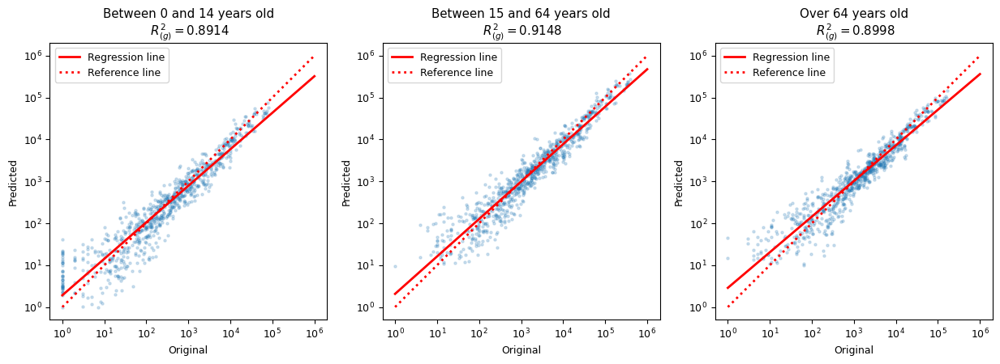

In [17]:
titles = ['Between 0 and 14 years old\n $R^2_{{(g)}}={:.4f}$',
          'Between 15 and 64 years old\n $R^2_{{(g)}}={:.4f}$',
          'Over 64 years old\n $R^2_{{(g)}}={:.4f}$']

titles = [title.format(r2_scores_test[i]) for i, title in enumerate(titles)]

plt.rcParams.update({'font.size': 9})
plt.rc('legend', fontsize=9)

fig, axes = plt.subplots(1,3,figsize=(15,5),sharex=True, sharey=True)

for i,ax in enumerate(axes):
    ax.set_aspect('equal', adjustable='box') 

    ax.scatter(test_labels_logged[:,i], test_outputs[:,i], s=5, alpha=.2)

    coeffs = np.polyfit(test_labels_logged[:, i], test_outputs[:, i], deg=1)
    x_range = np.linspace(0, 6, 100)
    y_range = np.polyval(coeffs, x_range)
    y_reference = np.linspace(0, 6, 100)
    ax.plot(x_range, y_range, color='red', linewidth=2, label= "Regression line")
    ax.plot(x_range, y_reference, color='red', linestyle="dotted", linewidth=2, label="Reference line")

    ax.set_title(titles[i])
    ax.set_xlabel('Original')
    ax.set_ylabel('Predicted')
    ax.yaxis.set_tick_params(labelbottom=True)
    ax.set_xticklabels(["$10^{}$".format(i-1) for i in range(8)])
    ax.set_yticklabels(["$10^{}$".format(i-1) for i in range(8)])
    ax.legend()

plt.show()

<div style='text-align: center; font-family: "Times New Roman"; font-size: 100%; line-height: 120%; max-width: 1024px;'>
<b>Figure 12.</b> Prediction performance of trained ResNet50 model by demographic composition groups.
</div>

<h3 style='text-align: justify; font-family: "Times New Roman"; max-width: 1024px;'>
<i>Generated Dataset for 2022</i>
</h3>

<div style='text-align: justify; font-family: "Times New Roman"; font-size: 100%; line-height: 120%; max-width: 1024px;'>
The trained CNN model was used for estimating demographic composition in Japan for 2022 as a non-census year. Firstly, mesh cells were employed from those utilised in the training, validation, and testing process. Columns for demographic composition were initialised as zero and year was set as 2022. Totally 4,225 mesh cells were targeted for the dataset generation.
</div>

In [196]:
# collect unique mesh cells
non_census_gdf = master_gdf[['MESH1_ID', 'MESH2_ID', 'KEY_CODE', 'geometry']].drop_duplicates().copy()

# initialise the columns of demographic compositions as zero
non_census_gdf[['0_14', '15_64', 'over_64']] = 0

# initialise the column of year as 2022
non_census_gdf['year'] = 2022

In [191]:
non_census_gdf

,MESH1_ID,MESH2_ID,KEY_CODE,geometry,0_14,15_64,over_65,year
0,6842,00,6842004950,"POLYGON ((142.00000 45.37500, 142.00000 45.383...",0,0,0,2022
1,6842,01,6842014950,"POLYGON ((142.12500 45.37500, 142.12500 45.383...",0,0,0,2022
2,6842,10,6842104950,"POLYGON ((142.00000 45.45833, 142.00000 45.466...",0,0,0,2022
3,4729,35,4729354950,"POLYGON ((129.62500 31.62500, 129.62500 31.633...",0,0,0,2022
4,4729,45,4729454950,"POLYGON ((129.62500 31.70833, 129.62500 31.716...",0,0,0,2022
...,...,...,...,...,...,...,...,...
6191,4530,51,4530514950,"POLYGON ((130.12500 30.45833, 130.12500 30.466...",0,0,0,2022
6861,6442,77,6442774950,"POLYGON ((142.87500 43.29167, 142.87500 43.300...",0,0,0,2022
7307,5940,76,5940764950,"POLYGON ((140.75000 39.95833, 140.75000 39.966...",0,0,0,2022
7534,5338,11,5338114950,"POLYGON ((138.12500 35.45833, 138.12500 35.466...",0,0,0,2022


<div style='text-align: justify; font-family: "Times New Roman"; font-size: 100%; line-height: 120%; max-width: 1024px;'>
With the created table "non_census_gdf", an instance of "RemoteSensingDataset" was created and used as an input for "torch.utils.data.DataLoader" object with a batch size of 32 without shuffling. Also, an instance of the CNN model was initialised and its pre-trained parameters were imported from the best model. The pretrained CNN model was used for estimating demographic composition through forward propagation and the outputs were stored in "non_census_outputs". The outputs were concatenated and stored in the initialised columns as original numbers. Moreover, for further visualisation, the ratio of the aged population in mesh cells was calculated, by dividing the number of the population over 64 years old by the total in the mesh cells. The table was then saved as GeoJSON.
</div>

In [192]:
# initialise Dataset and DataLoader
non_census_dataset = RemoteSensingDataset(non_census_gdf)
non_census_loader  = DataLoader(non_census_dataset,  batch_size=32, shuffle=False)

# initialise a CNN model
remote_sensing_cnn = RemoteSensingCNN(out_dim=3, pretrained=True)

# set device
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

# import the parameters of the best model
remote_sensing_cnn.load_state_dict(torch.load('../src/pretrained/best_model', map_location=torch.device(device)))

# set device
remote_sensing_cnn.to(device)

# set as evaluation mode
remote_sensing_cnn.eval()

# initialise a list to store the output
non_census_outputs = []

# set seed
torch.manual_seed(1)

for i, (img, label) in enumerate(non_census_loader):
    with torch.no_grad():
        # convert images and labels to either CPU tensor or GPU tensor
        img, label = img.to(device), label.to(device)

        # execute forward propagation
        non_census_output = remote_sensing_cnn(img)

        # store the outputs
        non_census_outputs.append(non_census_output.cpu().detach().numpy().copy())

        # clean up the memory
        gc.collect()

# aggregate outputs
non_census_outputs = np.concatenate(non_census_outputs)

# store the original numbers of estimated demographic compositions
non_census_gdf[['0_14', '15_64', 'over_64']] = 10 ** non_census_outputs

# calculate the agining population rate
non_census_gdf['aging_pop_rate'] = 100 * non_census_gdf['over_64'] / non_census_gdf[['0_14', '15_64', 'over_64']].sum(axis=1)

# save the file
non_census_gdf.to_file('../data/census/non_census_gdf.geojson', driver='GeoJSON')

In [131]:
non_census_gdf

,MESH1_ID,MESH2_ID,KEY_CODE,0_14,15_64,over_64,year,aging_pop_rate,geometry
0,6842,00,6842004950,22.6158,157.4638,148.9093,2022,45.2627,"POLYGON ((142.00000 45.37500, 142.00000 45.383..."
1,6842,01,6842014950,24.4707,125.8835,91.6684,2022,37.8760,"POLYGON ((142.12500 45.37500, 142.12500 45.383..."
2,6842,10,6842104950,1.0000,10.6109,16.4361,2022,58.6020,"POLYGON ((142.00000 45.45833, 142.00000 45.466..."
3,4729,35,4729354950,50.0156,259.3936,344.3385,2022,52.6715,"POLYGON ((129.62500 31.62500, 129.62500 31.633..."
4,4729,45,4729454950,55.1823,349.4573,486.5774,2022,54.5970,"POLYGON ((129.62500 31.70833, 129.62500 31.716..."
...,...,...,...,...,...,...,...,...,...
4220,4530,51,4530514950,5.2601,48.0287,72.1833,2022,57.5294,"POLYGON ((130.12500 30.45833, 130.12500 30.466..."
4221,6442,77,6442774950,3.0777,20.6058,13.9328,2022,37.0392,"POLYGON ((142.87500 43.29167, 142.87500 43.300..."
4222,5940,76,5940764950,2.4714,25.9159,21.0559,2022,42.5860,"POLYGON ((140.75000 39.95833, 140.75000 39.966..."
4223,5338,11,5338114950,44.5895,295.3474,266.7152,2022,43.9651,"POLYGON ((138.12500 35.45833, 138.12500 35.466..."


In [49]:
# read the file
non_census_gdf = gpd.read_file('../data/census/non_census_gdf.geojson')

<div style='text-align: justify; font-family: "Times New Roman"; font-size: 100%; line-height: 120%; max-width: 1024px;'>
Using the estimated demographic composition, a choropleth of the ratio of estimated aged population was visualised in Figure 13. The colour was binned with deciles. As seen in Figure 13, the estimation of aged population rate implied that the urbanised area around Tokyo, Osaka, and Nagoya enjoyed the prosperity of abundant labour force with children, while the others tended to suffer from the deficit of young population.
</div>

In [77]:
centroid = non_census_gdf.unary_union.centroid

m = folium.Map(
    tiles='cartodbpositron',
    location=[centroid.bounds[1], centroid.bounds[0]],
    zoom_start=5)

cp = folium.Choropleth(geo_data='../data/census/non_census_gdf.geojson',
                       name = 'Aged population rate',
                       data = non_census_gdf,
                       columns=['KEY_CODE', 'aging_pop_rate'],
                       key_on="feature.properties.KEY_CODE",
                       fill_opacity=0.8, 
                       line_opacity=0,
                       fill_color='BuPu',
                       legend_name="Ratio of population over 64 years old (%)",
                       bins=[i * 10 for i in range(11)],
                      ).add_to(m)

folium.GeoJsonTooltip(fields=['year', 'aging_pop_rate', '0_14', '15_64', 'over_64'],
                      aliases=['Year', 'Ratio of population over 64 years old (%)', 'Population between 0 and 14 years old', 'Population between 15 and 64 years old', 'Population over 64 years old']).add_to(cp.geojson)


folium.LayerControl().add_to(m)

m

<div style='text-align: center; font-family: "Times New Roman"; font-size: 100%; line-height: 120%; max-width: 1024px;'>
<b>Figure 13.</b> Estimated rate of aged population in Japan as of 2022. The map is based on OpenStreetMap.
</div>

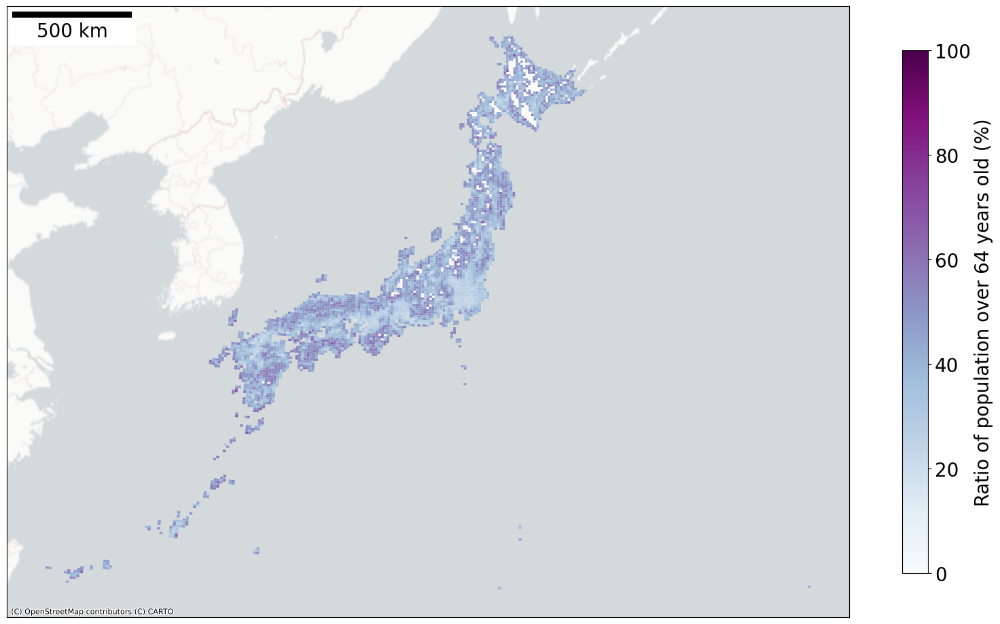

In [24]:
non_census_gdf = non_census_gdf.to_crs(6691)

fig, ax = plt.subplots(1,1,figsize=(20,20))

non_census_gdf.plot(column='aging_pop_rate',
                    legend=True,
                    cmap='BuPu',
                    vmin = 0,
                    vmax = 100,
                    #scheme="User_Defined",
                    #classification_kwds=dict(bins=[i * 10 for i in range(11)]),
                    legend_kwds={
                        "label": "Ratio of population over 64 years old (%)",
                        "shrink":0.5},
                    alpha=1,
                    ax=ax)

ax.set_xticks([])
ax.set_yticks([])
cx.add_basemap(ax, source=cx.providers.CartoDB.PositronNoLabels, crs=non_census_gdf.crs, zoom=5)

ax.add_artist(ScaleBar(
    dx=1,
    location="upper left"))

ax.arrow(0, 0, 0, 1, length_includes_head=True,
          head_width=0.8, head_length=1.5, overhang=.1, facecolor='k') # North Arrow

plt.rcParams.update({'font.size': 20})
plt.rc('legend', fontsize=18)

<h2 style='text-align: justify; font-family: "Times New Roman"; max-width: 1024px;'>
6. Discussion
</h2>

<div style='text-align: justify; font-family: "Times New Roman"; font-size: 100%; line-height: 120%; max-width: 1024px;'>
As population aging is in progress among an increasing number of countries and regions, prompt understanding of demographic composition is of urgent importance. This paper demonstrated the mesh-wise estimation of demographic composition in Japan as one of the countries with the most aged society in the world, from the dataset of population census in 2015 and 2020 as labels and satellite images of Landsat-8/OLI and Suomi NPP/VIIRS-DNS. The chosen ResNet50-based CNN model after the training and validation process was tested by the testing dataset with metrics of $R^2_{(g)}$ between original and estimated values for each of the demographic composition groups $g$. In the end, the trained model was used for estimating the demographic composition of Japan in 2022 as a non-census year, and the aged population rate was visualised. The result showed a remarkable test score of $R^2_{(g)}$ with at least 0.8914 for all the demographic composition groups $g$, indicating three contributions of following; Firstly, the result displays the effective usage of pre-trained ResNet50 (He et al., 2016) from the ImageNet dataset consisting of more than 1.2 million images as a 1,000-objects classification task for the demographic composition estimation task with only 6,724 training samples. This result corresponds to previous studies (i.e. Huang et al., 2021) in the sense that the remote sensing tasks share a similar domain with the ImageNet object classification task as image recognition. Secondly, this paper proposes the feasibility of estimating demographic composition rather than total population from satellite images, so that the progress of population aging could be observed without conducting formal surveys such as census. As the values of the loss function both for the validation and testing dataset were not deviated from around 0.32, it is reasonable to confirm that the model held generalisability enough to estimate other geographical locations which were not included in this dataset. Lastly, the proposed CNN model only employed publicly available satellite images as inputs for enduring generalisability in any other geographic location. Since Landsat-8/OLI and Suomi NPP/VIIRS-DNS cover the surface of the earth holistically and periodically, the trained CNN model could be further utilised in other countries in any year. Considering the performance and data availability, the proposed model could help fulfilling the gap between census years not only in Japan but also the other countries and regions for the purposes of urban planning policymaking, especially where rigorous population surveys are limited due to a lack of financial and human resources. 
</div>

<div style='text-align: justify; font-family: "Times New Roman"; font-size: 100%; line-height: 120%; max-width: 1024px;'>
However, there are certain limitations in the proposed CNN model when it comes to enduring generalisability for further usage. First and foremost, biases in the dataset could result in overfitting in other datasets out of this paper. In terms of the spatial biases stemming from the dataset, the proposed CNN model was trained only by the satellite images in the realm of the population census held by the Japanese government. Since this paper did not conduct testing by a dataset from other countries and regions, the generalisability of the trained CNN model is still uncertain if the condition of morphological landscape in satellite images is different from the one in Japan. To consider the temporal biases in the proposed CNN model, the dataset was obtained from the years 2015 and 2020, where each sample was independently treated and did not explicitly consider the temporal relationship in the same geographical location. Also, the satellite images were pre-processed by annually averaging pixel values from those without clouds, which lacked temporal transition within a sample year. From the model architecture point of view, one way to enhance the proposed CNN model for overcoming these problems is to implement spatio-temporal CNN with the introduction of Long Short-Term Memory (LSTM) blocks (Yu et al., 2022) or Attention mechanism (Yang et al., 2022). Moreover, rather simply and naturally, data argumentation by expanding the geographical locations and sample years could improve the proposed CNN model. Another limitation is the precision of the proposed CNN model. Although the test score reached 0.8914 for the $R^2_{(g)}$ of all the demographic composition groups $g$ in the testing dataset, Figure 12 indicates “heteroscedasty” in the correlation between the original and estimated values. In particular, samples with small population tended to be overestimated with poor precision and higher variance than the others. This could be due to the spatial resolution of the satellite images in the input, where 30m for Landasat-8/OLI and 750m for Suomi NPP/VIIRS-DNS were not granular enough to detect the shape of individual buildings in the extent. Not surprisingly, replacement of Landasat-8/OLI and Suomi NPP/VIIRS-DNS with finer satellite images and stacking of other data sources like spatially interpolated POI data would solve this problem. However, this approach would limit the data availability for geographical locations where the data source cannot be obtained. One potential method without employing new data sources is to synthesise satellite images with finer spatial resolution using Generative Adversarial Network (GAN) for super-resolution (Kong et al., 2023). In future studies, the proposed CNN model could be applied to the other countries and regions with super-resolution to enhance the generalisability and precision for further trustworthy estimation.
</div>

<h2 style='text-align: justify; font-family: "Times New Roman"; max-width: 1024px;'>
7. Conclusion
</h2>

<div style='text-align: justify; font-family: "Times New Roman"; font-size: 100%; line-height: 120%; max-width: 1024px;'>
This paper proposed a multi-head CNN model based on pretrained ResNet50 to estimate demographic composition in Japan as one of the most aged societies from the dataset of satellite images Landsat-8/OLI as daytime and Suomi NPP/VIIRS-DNS as night-time in the year 2015 and 2020. The trained model showed at least 0.8914 in $R^2_{(g)}$ for all the demographic composition groups $g$ of people below 14 years old, between 15 and 64 years old, and over 64 years old in the testing dataset. The trained model estimated the demographic composition in 2022 as a fulfilment ofa dataset in one of the non-census years of Japan. Since the proposed CNN model requires inputs only from publicly available satellite images at any location on the earth, it holds generalisability to other countries and regions in terms of data availability. Although further studies are expected for evaluating the performance in different geographical locations and enhancing the coarse spatial resolution in the inputs, this paper shall contribute to policymaking for solving problems amongst population aging without conducting q rigorous population survey such as a census
</div>

<h2 style='text-align: justify; font-family: "Times New Roman"; max-width: 1024px;'>
8. References
</h2>

<div style='text-align: left; font-family: "Times New Roman"; font-size: 100%; line-height: 120%; max-width: 1024px;'>
Alley, D., Liebig, P., Pynoos, J., Banerjee, T., &amp; Choi, I. H. (2007). Creating elder-friendly communities. Journal of Gerontological Social Work, 49(1–2), 1–18. https://doi.org/10.1300/j083v49n01_01 
</div>

<div style='text-align: left; font-family: "Times New Roman"; font-size: 100%; line-height: 120%; max-width: 1024px;'>
AWS. (2023). Amazon EC2 G4 Instances. Amazon.com. https://aws.amazon.com/ec2/instance-types/g4/ 
</div>

<div style='text-align: left; font-family: "Times New Roman"; font-size: 100%; line-height: 120%; max-width: 1024px;'>
Bagan, H., & Yamagata, Y. (2015). Analysis of urban growth and estimating population density using satellite images of nighttime lights and land-use and population data. GIScience &amp; Remote Sensing, 52(6), 765–780. https://doi.org/10.1080/15481603.2015.1072400
</div>

<div style='text-align: left; font-family: "Times New Roman"; font-size: 100%; line-height: 120%; max-width: 1024px;'>
Barentine, J. C., Walczak, K., Gyuk, G., Tarr, C., & Longcore, T. (2021). A case for a new satellite mission for remote sensing of Night Lights. Remote Sensing, 13(12), 2294. https://doi.org/10.3390/rs13122294
</div>

<div style='text-align: left; font-family: "Times New Roman"; font-size: 100%; line-height: 120%; max-width: 1024px;'>
Bongaarts, J. (2004). Population aging and the rising cost of public pensions. Population and Development Review, 30(1), 1–23. https://doi.org/10.1111/j.1728-4457.2004.00001.x
</div>

<div style='text-align: left; font-family: "Times New Roman"; font-size: 100%; line-height: 120%; max-width: 1024px;'>
Campos-Taberner, M., García-Haro, F. J., Martínez, B., Izquierdo-Verdiguier, E., Atzberger, C., Camps-Valls, G., &amp; Gilabert, M. A. (2020). Understanding deep learning in land use classification based on Sentinel-2 time series. Scientific Reports, 10(1). https://doi.org/10.1038/s41598-020-74215-5
</div>

<div style='text-align: left; font-family: "Times New Roman"; font-size: 100%; line-height: 120%; max-width: 1024px;'>
Cheng, L., Wang, L., Feng, R., &amp; Yan, J. (2021). Remote Sensing and Social Sensing Data Fusion for Fine-Resolution Population Mapping With a Multimodel Neural Network. IEEE Journal of Selected Topics in Applied Earth Observations and Remote Sensing, 14, 5973–5987. https://doi.org/10.1109/jstars.2021.3086139
</div>

<div style='text-align: left; font-family: "Times New Roman"; font-size: 100%; line-height: 120%; max-width: 1024px;'>
de Bem, P., de Carvalho Junior, O., Fontes Guimarães, R., &amp; Trancoso Gomes, R. (2020). Change detection of deforestation in the Brazilian amazon using landsat data and Convolutional Neural Networks. Remote Sensing, 12(6), 901. https://doi.org/10.3390/rs12060901
</div>

<div style='text-align: left; font-family: "Times New Roman"; font-size: 100%; line-height: 120%; max-width: 1024px;'>
Deng, L. (2014). A tutorial survey of Architectures, algorithms, and applications for Deep Learning. APSIPA Transactions on Signal and Information Processing, 3(1). https://doi.org/10.1017/atsip.2013.9
</div>

<div style='text-align: left; font-family: "Times New Roman"; font-size: 100%; line-height: 120%; max-width: 1024px;'>
e-Stat. (2023). Population census. Portal Site of Official Statistics of Japan. https://www.e-stat.go.jp/en/stat-search?page=1&amp;toukei=00200521&amp;toukei_kind=6&amp;metadata=1&amp;data=1
</div>

<div style='text-align: left; font-family: "Times New Roman"; font-size: 100%; line-height: 120%; max-width: 1024px;'>
Earth Observation Group. (2023). See the world at night. VIIRS Nighttime Light. https://eogdata.mines.edu/products/vnl/
</div>

<div style='text-align: left; font-family: "Times New Roman"; font-size: 100%; line-height: 120%; max-width: 1024px;'>
Elvidge, C., Zhizhin, M., Hsu, F.-C., &amp; Baugh, K. (2013). VIIRS Nightfire: Satellite Pyrometry at Night. Remote Sensing, 5(9), 4423–4449. https://doi.org/10.3390/rs5094423 
</div>

<div style='text-align: left; font-family: "Times New Roman"; font-size: 100%; line-height: 120%; max-width: 1024px;'>
Elvidge, C. D., Zhizhin, M., Ghosh, T., Hsu, F.-C., &amp; Taneja, J. (2021). Annual time series of global VIIRS Nighttime Lights derived from monthly averages: 2012 to 2019. Remote Sensing, 13(5), 922. https://doi.org/10.3390/rs13050922
</div>

<div style='text-align: left; font-family: "Times New Roman"; font-size: 100%; line-height: 120%; max-width: 1024px;'>
ESA. (2023). Sentinel Overview. Sentinel Online. https://sentinel.esa.int/web/sentinel/missions
</div>

<div style='text-align: left; font-family: "Times New Roman"; font-size: 100%; line-height: 120%; max-width: 1024px;'>
Feldhoff, T. (2012). Shrinking communities in Japan: Community ownership of assets as a development potential for rural Japan? URBAN DESIGN International, 18(1), 99–109. https://doi.org/10.1057/udi.2012.26
</div>

<div style='text-align: left; font-family: "Times New Roman"; font-size: 100%; line-height: 120%; max-width: 1024px;'>
Gillies, S. (2023). rasterio Documentation. Read the Docs. https://buildmedia.readthedocs.org/media/pdf/rasterio/stable/rasterio.pdf
</div>

<div style='text-align: left; font-family: "Times New Roman"; font-size: 100%; line-height: 120%; max-width: 1024px;'>
Google. (2023). USGS landsat 8 level 2, Collection 2, tier 1. Earth Engine Data catalog. https://developers.google.com/earth-engine/datasets/catalog/LANDSAT_LC08_C02_T1_L2
</div>

<div style='text-align: left; font-family: "Times New Roman"; font-size: 100%; line-height: 120%; max-width: 1024px;'>
He, K., Zhang, X., Ren, S., &amp; Sun, J. (2016). Deep residual learning for image recognition. 2016 IEEE Conference on Computer Vision and Pattern Recognition (CVPR). https://doi.org/10.1109/cvpr.2016.90
</div>

<div style='text-align: left; font-family: "Times New Roman"; font-size: 100%; line-height: 120%; max-width: 1024px;'>
Henderson, J. V., Storeygard, A., &amp; Weil, D. N. (2012). Measuring economic growth from Outer Space. American Economic Review, 102(2), 994–1028. https://doi.org/10.1257/aer.102.2.994</div>

<div style='text-align: left; font-family: "Times New Roman"; font-size: 100%; line-height: 120%; max-width: 1024px;'>
Henderson, M., Yeh, E. T., Gong, P., Elvidge, C., & Baugh, K. (2003). Validation of urban boundaries derived from Global Night-time satellite imagery. International Journal of Remote Sensing, 24(3), 595–609. https://doi.org/10.1080/01431160304982
</div>

<div style='text-align: left; font-family: "Times New Roman"; font-size: 100%; line-height: 120%; max-width: 1024px;'>
Hu, W., Patel, J. H., Robert, Z.-A., Novosad, P., Asher, S., Tang, Z., Burke, M., Lobell, D., &amp; Ermon, S. (2019). Mapping Missing Population in Rural India: A Deep Learning Approach with Satellite Imagery. Proceedings of the 2019 AAAI/ACM Conference on AI, Ethics, and Society. https://doi.org/10.1145/3306618.3314263</div>

<div style='text-align: left; font-family: "Times New Roman"; font-size: 100%; line-height: 120%; max-width: 1024px;'>
Huang, X., Zhu, D., Zhang, F., Liu, T., Li, X., &amp; Zou, L. (2021). Sensing population distribution from satellite imagery via Deep Learning:model selection, neighboring effects, and systematic biases. IEEE Journal of Selected Topics in Applied Earth Observations and Remote Sensing, 14, 5137–5151. https://doi.org/10.1109/jstars.2021.3076630</div>

<div style='text-align: left; font-family: "Times New Roman"; font-size: 100%; line-height: 120%; max-width: 1024px;'>
Ioffe, S., &amp; Szegedy, C. (2015). Batch normalization: Accelerating deep network training by reducing internal covariate shift. arXiv.org. https://arxiv.org/abs/1502.03167</div>

<div style='text-align: left; font-family: "Times New Roman"; font-size: 100%; line-height: 120%; max-width: 1024px;'>
Jenice, A. R., &amp; Raimond, K. (2016). An overview of technological revolution in satellite image analysis. Journal of Engineering Science and Technology Review, 9(4), 1–5. https://doi.org/10.25103/jestr.094.01</div>

<div style='text-align: left; font-family: "Times New Roman"; font-size: 100%; line-height: 120%; max-width: 1024px;'>
Jordahl, K., Bossche, J. V. den, Fleischmann, M., Wasserman, J., McBride, J., Gerard, J., Tratner, J., Perry, M., Badaracco, A. G., Farmer, C., Hjelle, G. A., Snow, A. D., Cochran, M., Gillies, S., Culbertson, L., Bartos, M., Eubank, N., Maxalbert, Bilogur, A., … Leblanc, F. (2020). Geopandas/geopandas: V0.8.1. Zenodo. https://doi.org/10.5281/zenodo.3946761</div>

<div style='text-align: left; font-family: "Times New Roman"; font-size: 100%; line-height: 120%; max-width: 1024px;'>
Kaplan, G., Avdan, U., &amp; Avdan, Z. Y. (2018). Urban heat island analysis using the landsat 8 satellite data: A case study in Skopje, Macedonia. The 2nd International Electronic Conference on Remote Sensing, 2(7), 358. https://doi.org/10.3390/ecrs-2-05171</div>

<div style='text-align: left; font-family: "Times New Roman"; font-size: 100%; line-height: 120%; max-width: 1024px;'>
Kaufman, S., Rosset, S., &amp; Perlich, C. (2011). Leakage in Data Mining. ACM Transactions on Knowledge Discovery from Data, 6(4), 1–21. https://doi.org/10.1145/2382577.2382579</div>

<div style='text-align: left; font-family: "Times New Roman"; font-size: 100%; line-height: 120%; max-width: 1024px;'>
Kertzer, D. I., White, M. J., Bernardi, L., &amp; Gabrielli, G. (2009). Italy’s path to very low fertility: The adequacy of economic and second demographic transition theories. European Journal of Population / Revue Européenne de Démographie, 25(1), 89–115. https://doi.org/10.1007/s10680-008-9159-5</div>

<div style='text-align: left; font-family: "Times New Roman"; font-size: 100%; line-height: 120%; max-width: 1024px;'>
Kingma, D. P., &amp; Ba, J. (2017). Adam: A method for stochastic optimization. arXiv.org. https://arxiv.org/abs/1412.6980</div>

<div style='text-align: left; font-family: "Times New Roman"; font-size: 100%; line-height: 120%; max-width: 1024px;'>
Kong, J., Ryu, Y., Jeong, S., Zhong, Z., Choi, W., Kim, J., Lee, K., Lim, J., Jang, K., Chun, J., Kim, K.-M., &amp; Houborg, R. (2023). Super resolution of historic landsat imagery using a dual generative Adversarial Network (GAN) model with CubeSat constellation imagery for spatially enhanced long-term vegetation monitoring. ISPRS Journal of Photogrammetry and Remote Sensing, 200, 1–23. https://doi.org/10.1016/j.isprsjprs.2023.04.013
</div>

<div style='text-align: left; font-family: "Times New Roman"; font-size: 100%; line-height: 120%; max-width: 1024px;'>
Krizhevsky, A., Sutskever, I., &amp; Hinton, G. E. (2017). ImageNet classification with deep convolutional Neural Networks. Communications of the ACM, 60(6), 84–90. https://doi.org/10.1145/3065386</div>

<div style='text-align: left; font-family: "Times New Roman"; font-size: 100%; line-height: 120%; max-width: 1024px;'>
Li, X., Chen, S., Hu, X., &amp; Yang, J. (2019). Understanding the disharmony between dropout and batch normalization by variance shift. 2019 IEEE/CVF Conference on Computer Vision and Pattern Recognition (CVPR). https://doi.org/10.1109/cvpr.2019.00279</div>

<div style='text-align: left; font-family: "Times New Roman"; font-size: 100%; line-height: 120%; max-width: 1024px;'>
Mellander, C., Lobo, J., Stolarick, K., & Matheson, Z. (2015). Night-time Light Data: A good proxy measure for economic activity? PLoS One, 10(10). https://doi.org/10.1371/journal.pone.0139779
</div>

<div style='text-align: left; font-family: "Times New Roman"; font-size: 100%; line-height: 120%; max-width: 1024px;'>
Ministry of Land, Infrastructure, Transport and Tourism. (2020). 国土交通白書 2020. 2　東京一極集中と地方への影響. https://www.mlit.go.jp/hakusyo/mlit/r01/hakusho/r02/html/n1112000.html</div>

<div style='text-align: left; font-family: "Times New Roman"; font-size: 100%; line-height: 120%; max-width: 1024px;'>
Nakatani, H. (2019). Population aging in Japan: Policy transformation, sustainable development goals, Universal Health Coverage, and social determinates of health. Global Health &amp;amp; Medicine, 1(1), 3–10. https://doi.org/10.35772/ghm.2019.01011</div>

<div style='text-align: left; font-family: "Times New Roman"; font-size: 100%; line-height: 120%; max-width: 1024px;'>
NOAA. (2023). Suomi NPP Visible Infrared Imaging Radiometer Suite (VIIRS). NOAA National Calibration Center. https://ncc.nesdis.noaa.gov/VIIRS/</div>

<div style='text-align: left; font-family: "Times New Roman"; font-size: 100%; line-height: 120%; max-width: 1024px;'>
Office for National Statistics. (2023). Census. Office for National Statistics. https://www.ons.gov.uk/census</div>

<div style='text-align: left; font-family: "Times New Roman"; font-size: 100%; line-height: 120%; max-width: 1024px;'>
Paszke, A., Gross, S., Massa, F., Lerer, A., Bradbury, J., Chanan, G., Killeen, T., Lin, Z., Gimelshein, N., Antiga, L., Desmaison, A., Köpf, A., Yang, E., DeVito, Z., Raison, M., Tejani, A., Chilamkurthy, S., Steiner, B., Fang, L., … Chintala, S. (2019). Pytorch: An imperative style, high-performance deep learning library. arXiv.org. https://arxiv.org/abs/1912.01703</div>

<div style='text-align: left; font-family: "Times New Roman"; font-size: 100%; line-height: 120%; max-width: 1024px;'>
Pedregosa, F., Varoquaux, G., Gramfort, A., Michel, V., Thirion, B., Grisel, O., Blondel, M., Prettenhofer, P., Weiss, R., Dubourg, V., Vanderplas, J., Passos, A., Cournapeau, D., Brucher, M., Perrot, M., &amp; Duchesnay, É. (2011). Scikit-learn: Machine Learning in Python. The Journal of Machine Learning Research, 12, 2825–2830. https://doi.org/https://dl.acm.org/doi/10.5555/1953048.2078195</div>

<div style='text-align: left; font-family: "Times New Roman"; font-size: 100%; line-height: 120%; max-width: 1024px;'>
Phiri, D., Simwanda, M., Salekin, S., Nyirenda, V., Murayama, Y., &amp; Ranagalage, M. (2020). Sentinel-2 data for land cover/use mapping: A Review. Remote Sensing, 12(14), 2291. https://doi.org/10.3390/rs12142291</div>

<div style='text-align: left; font-family: "Times New Roman"; font-size: 100%; line-height: 120%; max-width: 1024px;'>
Rumelhart, D. E., Hinton, G. E., &amp; Williams, R. J. (1986). Learning representations by back-propagating errors. Nature, 323(6088), 533–536. https://doi.org/10.1038/323533a0</div>

<div style='text-align: left; font-family: "Times New Roman"; font-size: 100%; line-height: 120%; max-width: 1024px;'>
Russakovsky, O., Deng, J., Su, H., Krause, J., Satheesh, S., Ma, S., Huang, Z., Karpathy, A., Khosla, A., Bernstein, M., Berg, A. C., &amp; Fei-Fei, L. (2015). Imagenet Large Scale Visual Recognition Challenge. International Journal of Computer Vision, 115(3), 211–252. https://doi.org/10.1007/s11263-015-0816-y</div>

<div style='text-align: left; font-family: "Times New Roman"; font-size: 100%; line-height: 120%; max-width: 1024px;'>
Shin, H.-C., Roth, H. R., Gao, M., Lu, L., Xu, Z., Nogues, I., Yao, J., Mollura, D., &amp; Summers, R. M. (2016). Deep convolutional neural networks for computer-aided detection: CNN Architectures, dataset characteristics and transfer learning. IEEE Transactions on Medical Imaging, 35(5), 1285–1298. https://doi.org/10.1109/tmi.2016.2528162</div>

<div style='text-align: left; font-family: "Times New Roman"; font-size: 100%; line-height: 120%; max-width: 1024px;'>
Simonyan, K., &amp; Zisserman, A. (2015). Very deep convolutional networks for large-scale image recognition. arXiv.org. https://arxiv.org/abs/1409.1556</div>

<div style='text-align: left; font-family: "Times New Roman"; font-size: 100%; line-height: 120%; max-width: 1024px;'>
Solórzano, J. V., Mas, J. F., Gao, Y., &amp; Gallardo-Cruz, J. A. (2021). Land use land cover classification with U-Net: Advantages of combining sentinel-1 and sentinel-2 imagery. Remote Sensing, 13(18), 3600. https://doi.org/10.3390/rs13183600</div>

<div style='text-align: left; font-family: "Times New Roman"; font-size: 100%; line-height: 120%; max-width: 1024px;'>
Song, J., Tong, X., Wang, L., Zhao, C., &amp; Prishchepov, A. V. (2019). Monitoring finer-scale population density in urban functional zones: A remote sensing data fusion approach. Landscape and Urban Planning, 190, 103580. https://doi.org/10.1016/j.landurbplan.2019.05.011</div>

<div style='text-align: left; font-family: "Times New Roman"; font-size: 100%; line-height: 120%; max-width: 1024px;'>
Statistics Bureau of Japan. (2023a). Method of Demarcation for Grid Square. Statistics Bureau Home Page. https://www.stat.go.jp/english/data/mesh/05.html</div>

<div style='text-align: left; font-family: "Times New Roman"; font-size: 100%; line-height: 120%; max-width: 1024px;'>
Statistics Bureau of Japan. (2023b). population census. Statistics Bureau home page. https://www.stat.go.jp/english/data/kokusei/index.html</div>

<div style='text-align: left; font-family: "Times New Roman"; font-size: 100%; line-height: 120%; max-width: 1024px;'>
Szegedy, C., Wei Liu, Yangqing Jia, Sermanet, P., Reed, S., Anguelov, D., Erhan, D., Vanhoucke, V., &amp; Rabinovich, A. (2015). Going deeper with convolutions. 2015 IEEE Conference on Computer Vision and Pattern Recognition (CVPR), 1–9. https://doi.org/10.1109/cvpr.2015.7298594</div>

<div style='text-align: left; font-family: "Times New Roman"; font-size: 100%; line-height: 120%; max-width: 1024px;'>
Ulmas, P., &amp; Liiv, I. (2020). Segmentation of satellite imagery using U-net models for land cover classification. arXiv.org. https://arxiv.org/abs/2003.02899</div>

<div style='text-align: left; font-family: "Times New Roman"; font-size: 100%; line-height: 120%; max-width: 1024px;'>
US Census Bureau. (2022). Decennial census of population and housing by decades. Census.gov. https://www.census.gov/programs-surveys/decennial-census/decade.html</div>

<div style='text-align: left; font-family: "Times New Roman"; font-size: 100%; line-height: 120%; max-width: 1024px;'>
USGS. (2018). USGS eros archive - landsat archives - landsat 8 oli (operational land imager) and TIRS (thermal infrared sensor) level-1 Data Products Active. USGS.gov. https://www.usgs.gov/centers/eros/science/usgs-eros-archive-landsat-archives-landsat-8-oli-operational-land-imager-and</div>

<div style='text-align: left; font-family: "Times New Roman"; font-size: 100%; line-height: 120%; max-width: 1024px;'>
USGS. (2023). Landsat missions. USGS.gov. https://www.usgs.gov/landsat-missions</div>

<div style='text-align: left; font-family: "Times New Roman"; font-size: 100%; line-height: 120%; max-width: 1024px;'>
Wang, Y., Huang, C., Zhao, M., Hou, J., Zhang, Y., &amp; Gu, J. (2020). Mapping the population density in mainland China using NPP/viirs and points-of-interest data based on a random forests model. Remote Sensing, 12(21), 3645. https://doi.org/10.3390/rs12213645</div>

<div style='text-align: left; font-family: "Times New Roman"; font-size: 100%; line-height: 120%; max-width: 1024px;'>
Wasser, L., Joseph, M., McGlinchy, J., Palomino, J., Korinek, N., Holdgraf, C., &amp; Head, T. (2019). EarthPy: A python package that makes it easier to explore and plot raster and vector data using open source python tools. Journal of Open Source Software, 4(43), 1886. https://doi.org/10.21105/joss.01886</div>

<div style='text-align: left; font-family: "Times New Roman"; font-size: 100%; line-height: 120%; max-width: 1024px;'>
World Bank. (2023). Population ages 65 and above (% of total population). https://data.worldbank.org/indicator/SP.POP.65UP.TO.ZS
</div>

<div style='text-align: left; font-family: "Times New Roman"; font-size: 100%; line-height: 120%; max-width: 1024px;'>
World Health Organization. (2022). Ageing and health. World Health Organization. https://www.who.int/news-room/fact-sheets/detail/ageing-and-health</div>

<div style='text-align: left; font-family: "Times New Roman"; font-size: 100%; line-height: 120%; max-width: 1024px;'>
Wu, C., &amp; Murray, A. T. (2007). Population estimation using Landsat Enhanced Thematic Mapper imagery. Geographical Analysis, 39(1), 26–43. https://doi.org/10.1111/j.1538-4632.2006.00694.x</div>

<div style='text-align: left; font-family: "Times New Roman"; font-size: 100%; line-height: 120%; max-width: 1024px;'>
Yang, G., Yang, Y., Lu, Z., Yang, J., Liu, D., Zhou, C., &amp; Fan, Z. (2022). Sta-TSN: Spatial-temporal attention temporal segment network for action recognition in video. PLOS ONE, 17(3). https://doi.org/10.1371/journal.pone.0265115</div>

<div style='text-align: left; font-family: "Times New Roman"; font-size: 100%; line-height: 120%; max-width: 1024px;'>
Yang, J., Guo, J., Yue, H., Liu, Z., Hu, H., &amp; Li, K. (2019). CDnet: CNN-based cloud detection for remote sensing imagery. IEEE Transactions on Geoscience and Remote Sensing, 57(8), 6195–6211. https://doi.org/10.1109/tgrs.2019.2904868</div>

<div style='text-align: left; font-family: "Times New Roman"; font-size: 100%; line-height: 120%; max-width: 1024px;'>
Yu, D., Wang, X., Liang, P., &amp; Sun, X. (2022). Spatio-temporal convolutional residual network for regional commercial vitality prediction. Multimedia Tools and Applications, 81(19), 27923–27948. https://doi.org/10.1007/s11042-022-12845-9
</div>

<div style='text-align: left; font-family: "Times New Roman"; font-size: 100%; line-height: 120%; max-width: 1024px;'>
Zhuang, F., Qi, Z., Duan, K., Xi, D., Zhu, Y., Zhu, H., Xiong, H., &amp; He, Q. (2021). A comprehensive survey on Transfer Learning. Proceedings of the IEEE, 109(1), 43–76. https://doi.org/10.1109/jproc.2020.3004555</div>

<div style='text-align: left; font-family: "Times New Roman"; font-size: 100%; line-height: 120%; max-width: 1024px;'>
Özelkan, E. (2020). Water body detection analysis using NDWI indices derived from landsat-8 oli. Polish Journal of Environmental Studies, 29(2), 1759–1769. https://doi.org/10.15244/pjoes/110447</div>